In [265]:
# Import libraries used for the Project
import numpy as np 
import pandas as pd
from scipy import stats
from scipy.stats import skew, kurtosis


from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif
from sklearn.feature_selection import SelectFromModel


from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn import tree
from sklearn.metrics import roc_curve, roc_auc_score

from sklearn.metrics import plot_roc_curve
import matplotlib.pyplot as plt
import seaborn as sns

PART 1 - SUMMARY AND DATA CLEANING 

Load the Data Set

In [134]:
# Create a Data Frame
df = pd.read_csv("../Australia Rainfall 2 SP6 2022.csv")

In [135]:
# Have a look if the data is loaded 
df.head(5)

# We can also see ? for missing values 

,State,Station,Year,Month,Date,Day,Min °C,Max °C,Rain(mm),Average Rain (mm),...,Dir - 9:00 AM - km/h,Spd - 9:00AM - km/h,MSLP- hPa - 9:00AM,Temp °C- 3:00PM,RH -% 3:00PM,Cld 8th- 3:00 PM,Dir - 3:00 PM - km/h,Spd - 3:00PM - km/h,MSLP- hPa - 3:00PM,Rain(Y/N)
0,ACT,Canberra Airport {station 070351},2019,May,1,We,6.5,20.8,0,1.9,...,NNW,6,1022,20.1,61,8,WNW,13,1021.3,N
1,ACT,Canberra Airport {station 070351},2019,May,2,Th,8.8,23.8,0,1.9,...,ESE,4,1026.6,22.4,57,8,NW,11,1022.5,N
2,ACT,Canberra Airport {station 070351},2019,May,3,Fr,15.2,20.4,20.8,1.9,...,NNW,24,1019.1,18.9,75,?,N,33,1015.8,Y
3,ACT,Canberra Airport {station 070351},2019,May,4,Sa,5,19,0.6,1.9,...,Calm,?,1018.1,16.6,47,2,WNW,22,1015.6,Y
4,ACT,Canberra Airport {station 070351},2019,May,5,Su,4.9,17.4,0,1.9,...,S,24,1021,14.9,58,8,S,33,1019.4,N


Initial Data Summary

In [136]:
# Look at the DF shape
df.shape

(11848, 26)

In [137]:
# General information about each feature
df.info()

# I will need to change the data types to fully investigate the values and summaries of each feature

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11848 entries, 0 to 11847
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   State                     11848 non-null  object 
 1   Station                   11848 non-null  object 
 2   Year                      11848 non-null  int64  
 3   Month                     11848 non-null  object 
 4   Date                      11848 non-null  object 
 5   Day                       11848 non-null  object 
 6   Min °C                    11848 non-null  object 
 7   Max °C                    11848 non-null  object 
 8   Rain(mm)                  11848 non-null  object 
 9   Average Rain (mm)         11848 non-null  float64
 10  Max Wind gust Dir         11848 non-null  object 
 11  Max wind gust Spd - km/h  11848 non-null  object 
 12  Max wind gust-Time-local  11848 non-null  object 
 13  Temp °C- 9:00AM           11848 non-null  object 
 14  RH -% 

Initial Transformation

In [138]:
# First I will change the names, to long and hard to work with
df.columns

Index(['State', 'Station', 'Year', 'Month', 'Date', 'Day', 'Min °C', 'Max °C',
       'Rain(mm)', 'Average Rain (mm)', 'Max Wind gust Dir',
       'Max wind gust Spd - km/h', 'Max wind gust-Time-local',
       'Temp °C- 9:00AM', 'RH -% 9:00AM', 'Cld 8th- 9:00 AM',
       'Dir - 9:00 AM - km/h', 'Spd - 9:00AM - km/h', 'MSLP- hPa - 9:00AM',
       'Temp °C- 3:00PM', 'RH -% 3:00PM', 'Cld 8th- 3:00 PM',
       'Dir - 3:00 PM - km/h', 'Spd - 3:00PM - km/h', 'MSLP- hPa - 3:00PM',
       'Rain(Y/N)'],
      dtype='object')

In [139]:
# New names 
new_col_names = ['State', 'Station', 'Year', 'Month', 'Date', 'Day', 'Min_Temp', 'Max_Temp',
       'Rain_mm', 'AVG_Rain_mm', 'Wind_Mx_Dir',
       'Wind_Mx_Spd', 'Wind_Mx_Tim',
       'Temp_9am', 'RH_9am', 'Cld_9am',
       'Wind_Dir_9am', 'Wind_Spd_9am', 'MSLP_9am',
       'Temp_3pm', 'RH_3pm', 'Cld_3pm',
       'Wind_Dir_3pm', 'Wind_Spd_3pm', 'MSLP_3pm',
       'Rain']

# Change column names
df.columns = new_col_names

In [140]:
# Now we will replace the missing values for a numpy Nan
df.replace("?", np.nan, inplace=True)

In [141]:
# Create a function that will identify if the variable is Object, Integer or Float and convert it
def convert_dtype(feature):
    try:
        return pd.to_numeric(feature)
    except:
            return feature

In [142]:
# Transform Wind_Mx_Tim to time if required
# I'm leaving this if it will be helpful later on the project or for further analysis
df["Wind_Mx_Tim"] = df.apply(lambda x: x.Wind_Mx_Tim if pd.isna(x.Wind_Mx_Tim) else x.Date + "-" + x.Month + "-" + str(x.Year) + " " + x.Wind_Mx_Tim +":00", axis=1)
df["Wind_Mx_Tim"] = pd.to_datetime(df["Wind_Mx_Tim"])

# For the remaining I will keep only the hour for the feature
df["Wind_Mx_Tim"] = df["Wind_Mx_Tim"].dt.hour

# Transform the data types of the DF
df.loc[:, df.columns != "Wind_Mx_Tim"] = df.loc[:, df.columns != "Wind_Mx_Tim"].apply(convert_dtype)

# Check the new data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11848 entries, 0 to 11847
Data columns (total 26 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   State         11848 non-null  object 
 1   Station       11848 non-null  object 
 2   Year          11848 non-null  int64  
 3   Month         11848 non-null  object 
 4   Date          11846 non-null  float64
 5   Day           11846 non-null  object 
 6   Min_Temp      11736 non-null  float64
 7   Max_Temp      11697 non-null  float64
 8   Rain_mm       11652 non-null  float64
 9   AVG_Rain_mm   11848 non-null  float64
 10  Wind_Mx_Dir   10789 non-null  object 
 11  Wind_Mx_Spd   10789 non-null  float64
 12  Wind_Mx_Tim   10797 non-null  float64
 13  Temp_9am      11769 non-null  float64
 14  RH_9am        11749 non-null  float64
 15  Cld_9am       6076 non-null   float64
 16  Wind_Dir_9am  11755 non-null  object 
 17  Wind_Spd_9am  10903 non-null  float64
 18  MSLP_9am      10565 non-nu

Continue Data Summary

In [143]:
# Collect the non-numeric features of the data set
non_numeric = []
numeric = []

# Add the valus in a for loop
for col in df:
    if df[col].dtypes == "object":
        non_numeric.append(col)
    else:
        numeric.append(col)

# Let's see what we have
print("Non-Numeric", non_numeric)
print("Numeric", numeric)

Non-Numeric ['State', 'Station', 'Month', 'Day', 'Wind_Mx_Dir', 'Wind_Dir_9am', 'Wind_Dir_3pm', 'Rain']
Numeric ['Year', 'Date', 'Min_Temp', 'Max_Temp', 'Rain_mm', 'AVG_Rain_mm', 'Wind_Mx_Spd', 'Wind_Mx_Tim', 'Temp_9am', 'RH_9am', 'Cld_9am', 'Wind_Spd_9am', 'MSLP_9am', 'Temp_3pm', 'RH_3pm', 'Cld_3pm', 'Wind_Spd_3pm', 'MSLP_3pm']


In [144]:
# Create an interval variable for the invertval features
interval = ['Min_Temp', 'Max_Temp', 'Rain_mm', 'AVG_Rain_mm', 'Wind_Mx_Spd', 
            'Temp_9am', 'RH_9am', 'Wind_Spd_9am', 'MSLP_9am', 'Temp_3pm', 'RH_3pm', 'Wind_Spd_3pm', 'MSLP_3pm']

In [145]:
# Get the skewness of each Feature
df[interval].skew().round(2)

Min_Temp         0.18
Max_Temp         0.34
Rain_mm         11.75
AVG_Rain_mm      0.00
Wind_Mx_Spd      0.87
Temp_9am         0.29
RH_9am          -0.54
Wind_Spd_9am     1.05
MSLP_9am        -0.07
Temp_3pm         0.32
RH_3pm          -0.06
Wind_Spd_3pm     0.65
MSLP_3pm         0.04
dtype: float64

In [146]:
# Get Kurtosis of each feature
df[interval].kurtosis().round(2)

Min_Temp         -0.52
Max_Temp         -0.61
Rain_mm         225.14
AVG_Rain_mm       0.00
Wind_Mx_Spd       1.51
Temp_9am         -0.58
RH_9am           -0.15
Wind_Spd_9am      2.66
MSLP_9am          0.28
Temp_3pm         -0.61
RH_3pm           -0.63
Wind_Spd_3pm      0.58
MSLP_3pm         -0.02
dtype: float64

In [147]:
# After transforming the variables now we can look at the Summary statistic of the numerical features
df[interval].describe().round(2).transpose()

,count,mean,std,min,25%,50%,75%,max
Min_Temp,11736.0,12.54,7.07,-5.9,7.5,12.0,17.5,33.1
Max_Temp,11697.0,23.68,7.53,5.7,17.6,23.0,29.4,48.9
Rain_mm,11652.0,1.90,7.96,0.0,0.0,0.0,0.2,254.8
AVG_Rain_mm,11848.0,1.90,0.00,1.9,1.9,1.9,1.9,1.9
Wind_Mx_Spd,10789.0,39.41,13.67,2.0,30.0,37.0,46.0,120.0
Temp_9am,11769.0,17.42,7.26,-2.2,11.9,16.6,22.8,41.3
RH_9am,11749.0,66.26,21.15,4.0,54.0,68.0,82.0,100.0
Wind_Spd_9am,10903.0,14.96,8.78,2.0,9.0,13.0,20.0,111.0
MSLP_9am,10565.0,1018.18,7.37,984.5,1013.3,1018.0,1023.1,1041.1
Temp_3pm,10981.0,22.28,7.49,3.7,16.2,21.6,27.9,48.2


In [148]:
# Let's look at the total missing values per feature
print(df.isnull().sum())

# Let's look at percentage of missing values per feature
print("------ Percent of Total Feature -----------")
df.isnull().sum().apply(lambda x: round(x/8293,2)).sort_values(ascending=False)

# From here we can identify that Cld_3pm and Cld_9am is missing above 50% of all values, they woould not be useful features

State              0
Station            0
Year               0
Month              0
Date               2
Day                2
Min_Temp         112
Max_Temp         151
Rain_mm          196
AVG_Rain_mm        0
Wind_Mx_Dir     1059
Wind_Mx_Spd     1059
Wind_Mx_Tim     1051
Temp_9am          79
RH_9am            99
Cld_9am         5772
Wind_Dir_9am      93
Wind_Spd_9am     945
MSLP_9am        1283
Temp_3pm         867
RH_3pm           881
Cld_3pm         6529
Wind_Dir_3pm     878
Wind_Spd_3pm     915
MSLP_3pm        1287
Rain               0
dtype: int64
------ Percent of Total Feature -----------


Cld_3pm         0.79
Cld_9am         0.70
MSLP_3pm        0.16
MSLP_9am        0.15
Wind_Mx_Tim     0.13
Wind_Mx_Spd     0.13
Wind_Mx_Dir     0.13
RH_3pm          0.11
Wind_Spd_9am    0.11
Wind_Dir_3pm    0.11
Wind_Spd_3pm    0.11
Temp_3pm        0.10
Rain_mm         0.02
Max_Temp        0.02
Min_Temp        0.01
RH_9am          0.01
Wind_Dir_9am    0.01
Temp_9am        0.01
State           0.00
Station         0.00
AVG_Rain_mm     0.00
Day             0.00
Date            0.00
Month           0.00
Year            0.00
Rain            0.00
dtype: float64

In [149]:
# look at the values counts of each feature 
for col in df:
    print("------------------------------------------------")
    print("Feature:", col)
    print(df[col].value_counts())


# From here we can identify that AVG_Rain_mm has only one value, this is not a useful feature
# Also after investigating, Cld is a categorical ordinal variable 
# For the feature "Month", I can identify "Jun" and "June" we need to make one


------------------------------------------------
Feature: State
SA     1695
WA     1694
QLD    1692
VIC    1688
NSW    1686
TAS    1276
NT     1275
ACT     842
Name: State, dtype: int64
------------------------------------------------
Feature: Station
Hobart (Ellerslie Road) {station 094029}              427
Devonport Airport {station 091126}                    426
Tennant Creek Airport {station 015135}                425
Alice Springs Airport {station 015590}                425
Darwin Airport {station 014015}                       425
North Shields (Port Lincoln AWS) {station 018192}     425
Renmark Aero {station 024048}                         424
Perth Metro {station 009225}                          424
Broome Airport {station 003003}                       424
Albany {station 009500}                               424
 Launceston (Ti Tree Bend) {station 091237}           423
Mount Gambier Aero {station 026021}                   423
Adelaide (Kent Town) {station 023090}               

In [150]:
# First we replace Jun to June
df["Month"].replace("Jun", "June", inplace=True)

In [151]:
# I also want to further investigate the stations 
print(df[['State', 'Station']].groupby("State").value_counts())

# I can see that Ballarat has different values, I will have to merge them together to one
replacement = "Ballarat Aerodrome"
df['Station'] = df['Station'].apply(lambda x: replacement if x[:18] == replacement else x)

State  Station                                           
ACT    Tuggeranong (Isabella Plains) AWS {station 070339}    421
       Canberra Airport {station 070351}                     421
NSW    Penrith Lakes AWS {station 067113                     422
       Bellambi AWS {station 068228}                         422
       Newcastle University {station 061390}                 421
       Sydney (Observatory Hill) {station 066062}            421
NT     Alice Springs Airport {station 015590}                425
       Darwin Airport {station 014015}                       425
       Tennant Creek Airport {station 015135}                425
QLD    Townsville Aero {station 032040}                      423
       Gold Coast Seaway {station 040764}                    423
       Cairns Aero {station 031011}                          423
       Brisbane {station 040913}                             423
SA     North Shields (Port Lincoln AWS) {station 018192}     425
       Renmark Aero {station 024

In [152]:
# Unique number of values for all values excluding Na
df.nunique()


State             8
Station          28
Year              2
Month            12
Date             31
Day               7
Min_Temp        365
Max_Temp        382
Rain_mm         269
AVG_Rain_mm       1
Wind_Mx_Dir      16
Wind_Mx_Spd      59
Wind_Mx_Tim      24
Temp_9am        383
RH_9am           97
Cld_9am           9
Wind_Dir_9am     17
Wind_Spd_9am     36
MSLP_9am        454
Temp_3pm        385
RH_3pm           99
Cld_3pm           9
Wind_Dir_3pm     17
Wind_Spd_3pm     33
MSLP_3pm        433
Rain              2
dtype: int64

In [153]:
# Total number of unique values for non-interval excluding NA
df[df.columns[~df.columns.isin(interval)]].nunique()

State            8
Station         28
Year             2
Month           12
Date            31
Day              7
Wind_Mx_Dir     16
Wind_Mx_Tim     24
Cld_9am          9
Wind_Dir_9am    17
Cld_3pm          9
Wind_Dir_3pm    17
Rain             2
dtype: int64

Initial Visulisation

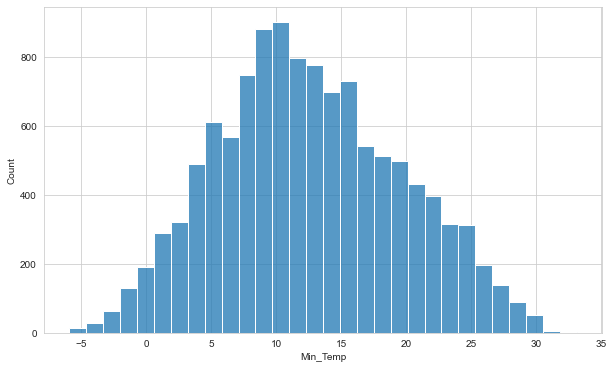

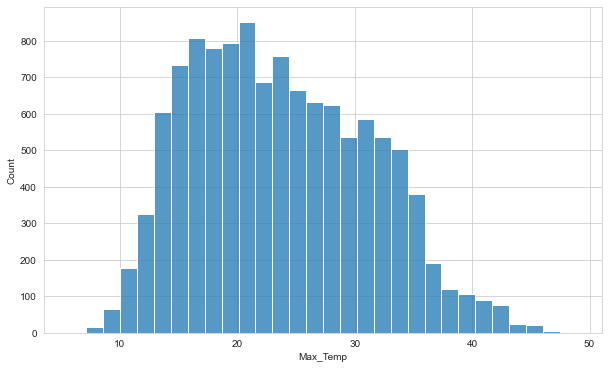

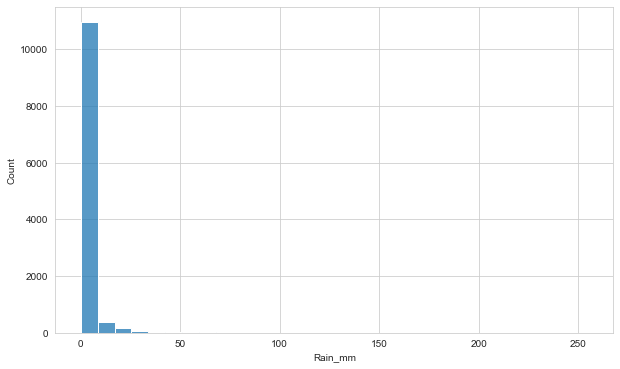

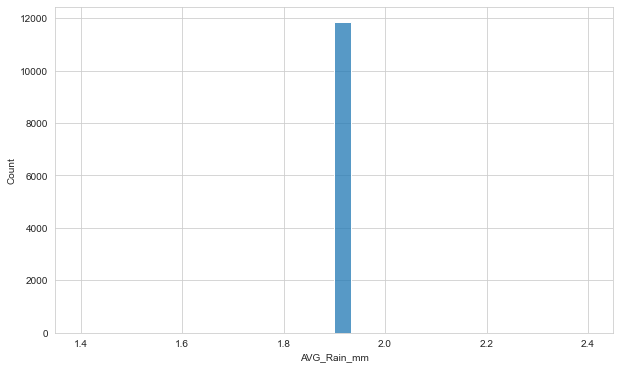

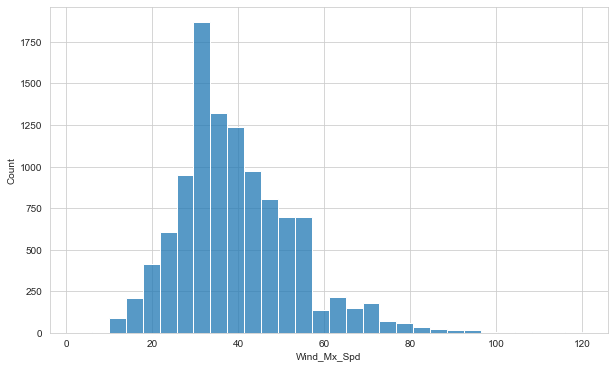

...

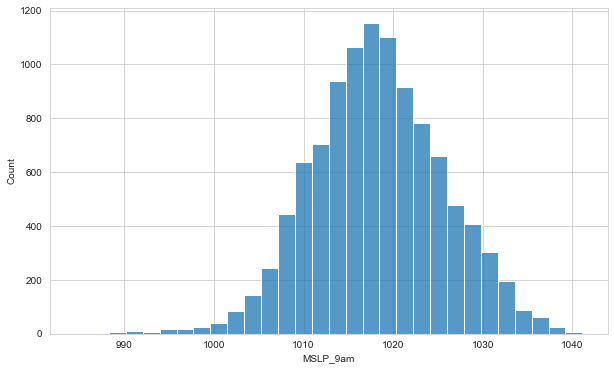

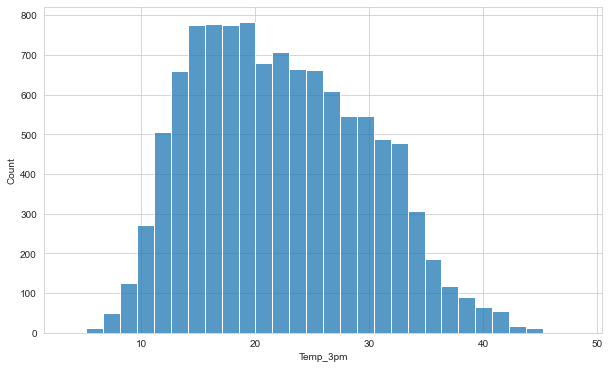

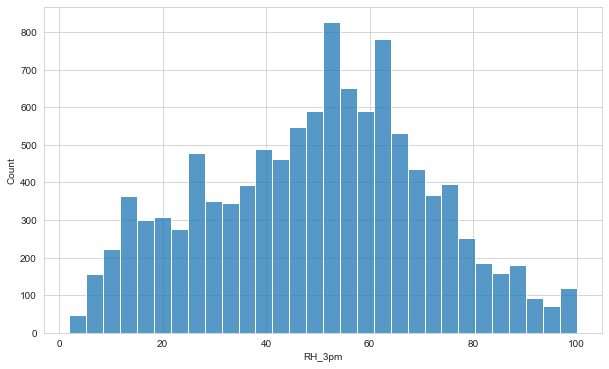

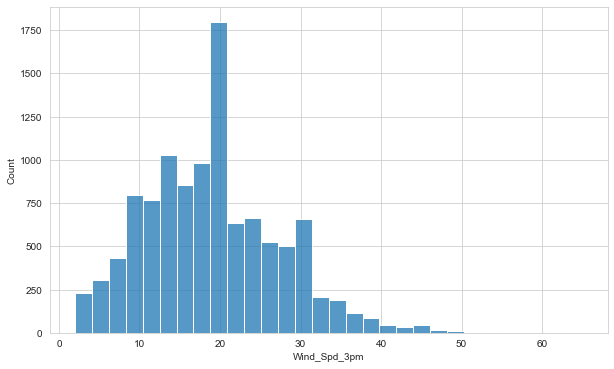

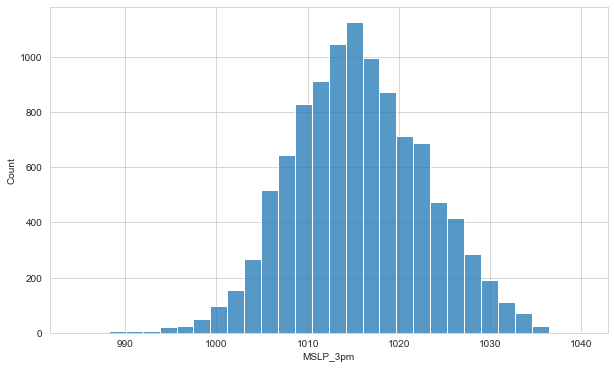

In [154]:
# Plot the Outcome of each individual feature
for feature in interval:
    sns.set_style("whitegrid")
    plt.figure(figsize=(10,6))
    sns.histplot(x=feature, data=df, bins=30)
    

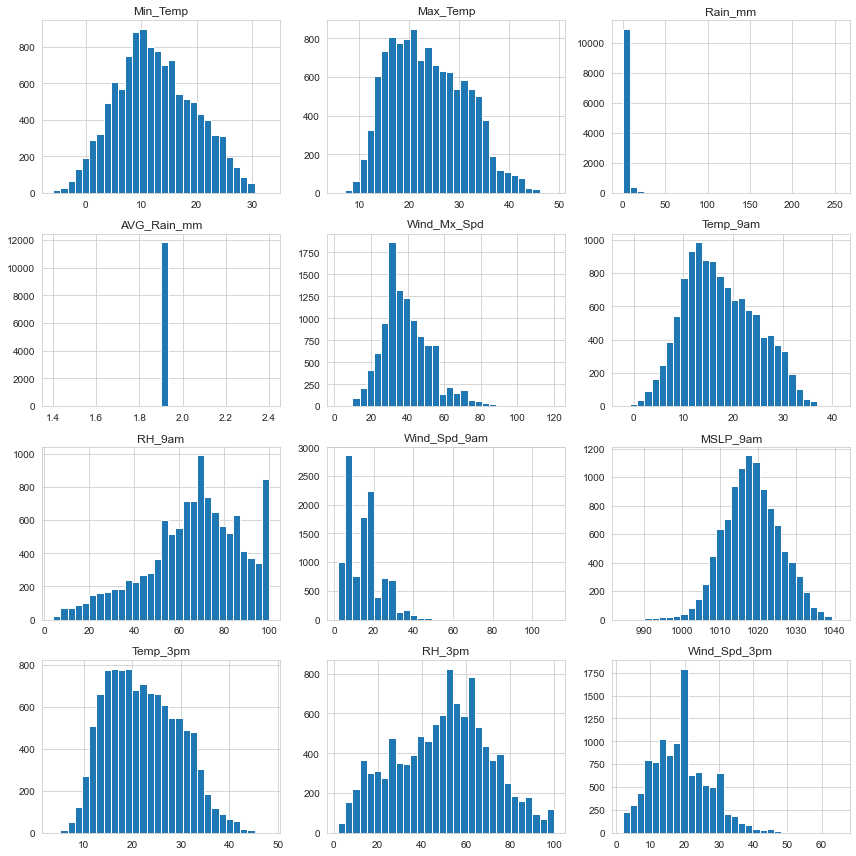

In [155]:
# Plot first 12 histograms in one page
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(12, 12))

for i, ax in enumerate(axes.flat):
    ax.hist(df[interval[i]], bins=30)
    ax.set_title(f'{interval[i]}'.format(i+1))

# Adjust the spacing between subplots
fig.tight_layout()

# Display the plot
plt.show()


Feature Engeniering 

1.- Missing Values

In [156]:
# First let's make a copy from the current DF to a new clean version
df_clean = df.copy()

In [157]:
# First let's go to our missing values
# For the cloud direction features we have more than 1/3 of total values as NA, for this case I'm choosing at removing the feature
# To replace those featues it will create an educated estimate, but at the same time we are using that estimate to create another prediction
# Thats why I choose to eliminate them in this case
# I'm also going to remove "AVG_Rain_mm" as the feature is usless as only has one value
df_clean.drop(["Cld_9am", "Cld_3pm", "AVG_Rain_mm"], axis=1, inplace=True)
interval.remove("AVG_Rain_mm")



In [158]:
# Now lets revisit which features have missing values
# We know that they range from 8% to 1% of total values of the feature
print(df_clean.isnull().sum().sort_values(ascending=False))

# I will collect the name of the features
features_na = df_clean.isnull().sum()
features_na = features_na[features_na > 0].index
features_na

# We have a mixture of numerical and non numerical 

MSLP_3pm        1287
MSLP_9am        1283
Wind_Mx_Dir     1059
Wind_Mx_Spd     1059
Wind_Mx_Tim     1051
Wind_Spd_9am     945
Wind_Spd_3pm     915
RH_3pm           881
Wind_Dir_3pm     878
Temp_3pm         867
Rain_mm          196
Max_Temp         151
Min_Temp         112
RH_9am            99
Wind_Dir_9am      93
Temp_9am          79
Day                2
Date               2
State              0
Station            0
Month              0
Year               0
Rain               0
dtype: int64


Index(['Date', 'Day', 'Min_Temp', 'Max_Temp', 'Rain_mm', 'Wind_Mx_Dir',
       'Wind_Mx_Spd', 'Wind_Mx_Tim', 'Temp_9am', 'RH_9am', 'Wind_Dir_9am',
       'Wind_Spd_9am', 'MSLP_9am', 'Temp_3pm', 'RH_3pm', 'Wind_Dir_3pm',
       'Wind_Spd_3pm', 'MSLP_3pm'],
      dtype='object')

In [159]:
# Lets look at the medina of the numerical featues, I'm choosing median as they are not normally distributed
print(df_clean[features_na].median())

# Let's see the change if we use the state 
print(df_clean.groupby("State")[features_na].median())

# We can see already see a difference for each state, let's take this further with each station
print(df_clean.groupby(["State","Station"])[features_na].median())

# Again this block creates further differences in how to hadle the NA values, 
# at the same time we can notice some particular stations might have more Na values like Newcastle University {station 061390}

Date              16.0
Min_Temp          12.0
Max_Temp          23.0
Rain_mm            0.0
Wind_Mx_Spd       37.0
Wind_Mx_Tim       13.0
Temp_9am          16.6
RH_9am            68.0
Wind_Spd_9am      13.0
MSLP_9am        1018.0
Temp_3pm          21.6
RH_3pm            51.0
Wind_Spd_3pm      19.0
MSLP_3pm        1015.3
dtype: float64
       Date  Min_Temp  Max_Temp  Rain_mm  Wind_Mx_Spd  Wind_Mx_Tim  Temp_9am  \
State                                                                          
ACT    16.0       5.8     18.90      0.0         37.0         14.0     11.60   
NSW    16.0      12.9     22.70      0.0         37.0         13.0     17.30   
NT     16.0      20.5     32.70      0.0         41.0         12.0     25.90   
QLD    16.0      19.1     27.90      0.0         35.0         13.0     23.85   
SA     16.0       9.7     19.80      0.0         39.0         13.0     14.10   
TAS    16.0       7.9     16.70      0.0         43.0         13.0     11.90   
VIC    16.0       8.1  

C:\Users\jmanu\AppData\Local\Temp\ipykernel_19220\311095657.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  print(df_clean[features_na].median())


In [160]:
# Now I will look at how many NA we have per station, I will use the initila DF to find if Na values in the "Cld_9am" and "Cld_3pm" is recurrent in all stations
for station in df["Station"].unique():
    print(f"-------------{station}----------")
    print(df[df["Station"] == station].isnull().sum())

# First we see that "Cld_9am" and "Cld_3pm" has null values for most stations, I'm happy at excluding those features 
# Second we can see that "Newcastle University {station 061390}" and "Albany {station 009500}" have a great ammount of NA in most of their features
# Lets find the total number of samples for each station and compare with the total NA from previous table 
print(df_clean["Station"][(df_clean["Station"] == "Newcastle University {station 061390}") | (df_clean["Station"] == "Albany {station 009500}")].value_counts())

# We can see that both stations have NA values for most of their featues in all samples, no educated guess will bu sufficient to replace those NA values


-------------Canberra Airport {station 070351}----------
State             0
Station           0
Year              0
Month             0
Date              0
Day               0
Min_Temp          0
Max_Temp          0
Rain_mm           0
AVG_Rain_mm       0
Wind_Mx_Dir       1
Wind_Mx_Spd       1
Wind_Mx_Tim       1
Temp_9am          0
RH_9am            0
Cld_9am         201
Wind_Dir_9am      0
Wind_Spd_9am     63
MSLP_9am          0
Temp_3pm          0
RH_3pm            0
Cld_3pm         198
Wind_Dir_3pm      0
Wind_Spd_3pm      5
MSLP_3pm          0
Rain              0
dtype: int64
-------------Tuggeranong (Isabella Plains) AWS {station 070339}----------
State             0
Station           0
Year              0
Month             0
Date              0
Day               0
Min_Temp          0
Max_Temp          0
Rain_mm           1
AVG_Rain_mm       0
Wind_Mx_Dir       1
Wind_Mx_Spd       1
Wind_Mx_Tim       1
Temp_9am          0
RH_9am            0
Cld_9am         421
Wind_Dir_9am    

In [161]:
# I want to look at how much of the total DF each of the last stations represent
df_clean["Station"].value_counts(normalize=True)

Hobart (Ellerslie Road) {station 094029}              0.036040
Devonport Airport {station 091126}                    0.035955
Tennant Creek Airport {station 015135}                0.035871
Alice Springs Airport {station 015590}                0.035871
Darwin Airport {station 014015}                       0.035871
North Shields (Port Lincoln AWS) {station 018192}     0.035871
Broome Airport {station 003003}                       0.035787
Albany {station 009500}                               0.035787
Perth Metro {station 009225}                          0.035787
Renmark Aero {station 024048}                         0.035787
Gold Coast Seaway {station 040764}                    0.035702
 Launceston (Ti Tree Bend) {station 091237}           0.035702
Mount Gambier Aero {station 026021}                   0.035702
Adelaide (Kent Town) {station 023090}                 0.035702
Townsville Aero {station 032040}                      0.035702
Cairns Aero {station 031011}                          0

In [162]:
# If we remove the last two stations, we will have a 7% reduction of the data but the data will be much cleaner, I will take that choice
# We will remove "Newcastle University {station 061390}" and "Albany {station 009500}"
df_clean = df_clean[(df_clean["Station"] != "Newcastle University {station 061390}") & (df_clean["Station"] != "Albany {station 009500}")]

In [163]:
# With the new DF let's look again at the missing values 
print("------ Percent of Total Feature -----------")
df_clean.isnull().sum().apply(lambda x: round(x/len(df_clean),2)).sort_values(ascending=False)

# For the remaining of the NA values, I will use the State as a blocking factor
# Interval will be replace with Median, as we don't have normally distributed features
# Categorical we will use the mode


------ Percent of Total Feature -----------


MSLP_3pm        0.08
MSLP_9am        0.08
Wind_Spd_9am    0.06
Wind_Mx_Tim     0.02
Wind_Mx_Dir     0.02
Wind_Mx_Spd     0.02
Wind_Spd_3pm    0.01
Max_Temp        0.01
Rain_mm         0.01
Wind_Dir_9am    0.00
Wind_Dir_3pm    0.00
RH_3pm          0.00
Temp_3pm        0.00
State           0.00
RH_9am          0.00
Temp_9am        0.00
Station         0.00
Min_Temp        0.00
Day             0.00
Date            0.00
Month           0.00
Year            0.00
Rain            0.00
dtype: float64

In [164]:
# Now we will use the State  to replace NA value
for state in df_clean.State.unique():
    for col in features_na:
       if col in interval:
          mean_val= round(df_clean.loc[df_clean["State"] == state, col].mean(), 2)
          df_clean.loc[df_clean["State"] == state, col] = df_clean.loc[df_clean["State"] == state, col].fillna(mean_val)
       else:
          mode_val = df_clean.loc[df_clean["State"] == state, col].mode()
          df_clean.loc[df_clean["State"] == state, col] = df_clean.loc[df_clean["State"] == state, col].fillna(mode_val[0])

In [165]:
# Lets look if we have any missing values
df_clean.isnull().sum()
 
# Yay

State           0
Station         0
Year            0
Month           0
Date            0
Day             0
Min_Temp        0
Max_Temp        0
Rain_mm         0
Wind_Mx_Dir     0
Wind_Mx_Spd     0
Wind_Mx_Tim     0
Temp_9am        0
RH_9am          0
Wind_Dir_9am    0
Wind_Spd_9am    0
MSLP_9am        0
Temp_3pm        0
RH_3pm          0
Wind_Dir_3pm    0
Wind_Spd_3pm    0
MSLP_3pm        0
Rain            0
dtype: int64

2.1 - Outliers 

In [166]:
# Now we want to look if we have any outliers on our numerical values
# Create a formula for that
def detect_outliers_iqr(data, factor=1.5):
    # Calculate the quartiles and IQR for each column in the DataFrame
    q1 = data.quantile(0.25)
    q3 = data.quantile(0.75)
    iqr = q3 - q1

    # Find the upper and lower bounds for outlier detection
    upper_bound = q3 + factor * iqr
    lower_bound = q1 - factor * iqr

    # Identify the outliers for each column in the DataFrame
    outliers = {}
    for col in data.columns:
        outliers[col] = data.index[(data[col] > upper_bound[col]) | (data[col] < lower_bound[col])].tolist()

    return outliers


In [167]:
# Find the outliers presnet on the interval features
outliers = detect_outliers_iqr(df_clean[interval])

# Print the outliers
for col, outlier_indices in outliers.items():
    if len(outlier_indices) > 0:
        print(f"{col}: {len(outlier_indices)} outliers")

Max_Temp: 2 outliers
Rain_mm: 2142 outliers
Wind_Mx_Spd: 286 outliers
Temp_9am: 1 outliers
RH_9am: 93 outliers
Wind_Spd_9am: 177 outliers
MSLP_9am: 183 outliers
Temp_3pm: 3 outliers
Wind_Spd_3pm: 171 outliers
MSLP_3pm: 131 outliers


2.2 Log Transform

In [168]:
# We identified 10 features with outliers and 5 with more than a hundred each, a good way to add normality to those features will be
# with a Log transform, first lets make a copy of the DF and transform the features
df_int_Log = df_clean[interval].copy()

df_int_Log

,Min_Temp,Max_Temp,Rain_mm,Wind_Mx_Spd,Temp_9am,RH_9am,Wind_Spd_9am,MSLP_9am,Temp_3pm,RH_3pm,Wind_Spd_3pm,MSLP_3pm
0,6.5,20.8,0.00,33.00,12.4,80.0,6.00,1022.0,20.1,61.0,13.0,1021.3
1,8.8,23.8,0.00,26.00,16.0,84.0,4.00,1026.6,22.4,57.0,11.0,1022.5
2,15.2,20.4,20.80,43.00,15.8,99.0,24.00,1019.1,18.9,75.0,33.0,1015.8
3,5.0,19.0,0.60,41.00,10.9,82.0,11.91,1018.1,16.6,47.0,22.0,1015.6
4,4.9,17.4,0.00,48.00,12.7,65.0,24.00,1021.0,14.9,58.0,33.0,1019.4
...,...,...,...,...,...,...,...,...,...,...,...,...
11843,17.7,27.3,0.00,50.00,19.7,41.0,33.00,1020.0,26.3,24.0,26.0,1016.2
11844,13.9,24.0,0.00,48.00,16.0,39.0,33.00,1021.1,23.5,22.0,17.0,1017.0
11845,11.4,23.9,0.00,44.00,16.5,42.0,26.00,1019.3,23.0,20.0,20.0,1015.3
11846,12.7,22.8,0.00,41.28,16.6,42.0,31.00,1021.0,22.4,27.0,31.0,1017.7


In [169]:
# Now we will transfor the features
df_int_Log = np.log1p(df_int_Log)

# We have some errors as we have 0 as value on Rain_mm and we have negative values on the minim temp
df_int_Log.isnull().sum()

# It could not be a big problem as Min_Temp feature didn't have outliers 

c:\Users\jmanu\anaconda3\lib\site-packages\pandas\core\internals\blocks.py:402: RuntimeWarning: divide by zero encountered in log1p
  result = func(self.values, **kwargs)
c:\Users\jmanu\anaconda3\lib\site-packages\pandas\core\internals\blocks.py:402: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)


Min_Temp        196
Max_Temp          0
Rain_mm           0
Wind_Mx_Spd       0
Temp_9am          2
RH_9am            0
Wind_Spd_9am      0
MSLP_9am          0
Temp_3pm          0
RH_3pm            0
Wind_Spd_3pm      0
MSLP_3pm          0
dtype: int64

In [170]:
# We can run the function with the new transform data to find how many outliers we have now 
outliers = detect_outliers_iqr(df_int_Log)

# Print the outliers
for col, outlier_indices in outliers.items():
    if len(outlier_indices) > 0:
        print(f"{col}: {len(outlier_indices)} outliers")
       

# It doesn't look good df_int_Log

Min_Temp: 445 outliers
Max_Temp: 4 outliers
Rain_mm: 2020 outliers
Wind_Mx_Spd: 231 outliers
Temp_9am: 174 outliers
RH_9am: 713 outliers
Wind_Spd_9am: 411 outliers
MSLP_9am: 174 outliers
Temp_3pm: 14 outliers
RH_3pm: 512 outliers
Wind_Spd_3pm: 237 outliers
MSLP_3pm: 125 outliers


In [171]:
# Look at statistics
df_int_Log.describe().round(2).transpose()

,count,mean,std,min,25%,50%,75%,max
Min_Temp,10807.0,-inf,NaN,-inf,2.15,2.57,2.93,3.53
Max_Temp,11003.0,3.16,0.32,1.90,2.92,3.19,3.42,3.91
Rain_mm,11003.0,0.40,0.82,0.00,0.00,0.00,0.34,5.54
Wind_Mx_Spd,11003.0,3.64,0.34,1.10,3.43,3.64,3.85,4.80
Temp_9am,11001.0,2.82,0.46,-2.30,2.55,2.87,3.18,3.74
RH_9am,11003.0,4.13,0.43,1.61,3.99,4.23,4.41,4.62
Wind_Spd_9am,11003.0,2.61,0.58,1.10,2.30,2.69,3.04,4.09
MSLP_9am,11003.0,6.93,0.01,6.89,6.92,6.93,6.93,6.95
Temp_3pm,11003.0,3.09,0.34,1.55,2.84,3.12,3.36,3.90
RH_3pm,11003.0,3.80,0.56,1.10,3.56,3.95,4.19,4.62


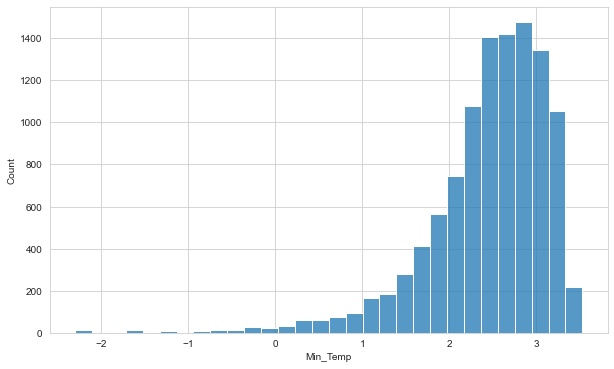

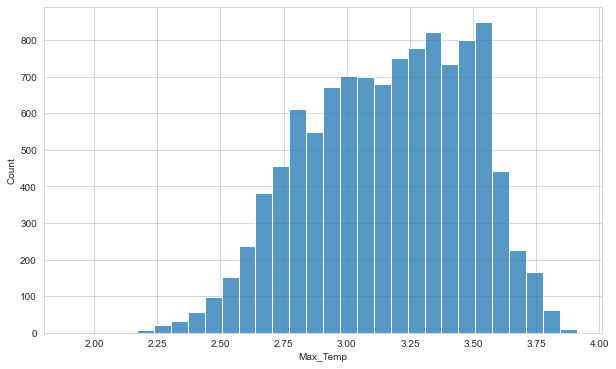

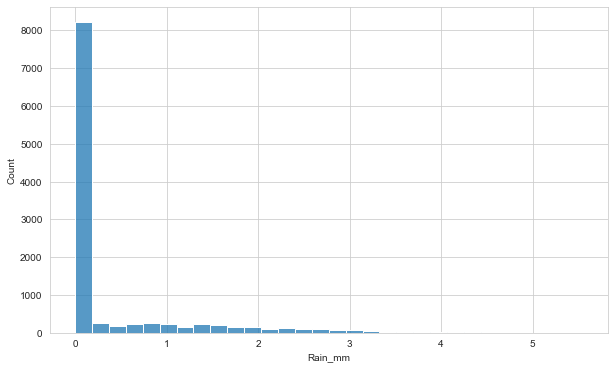

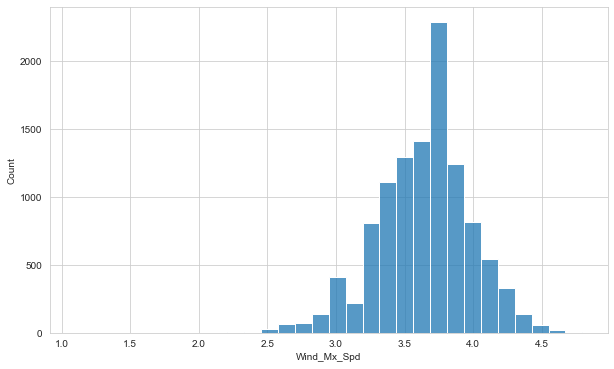

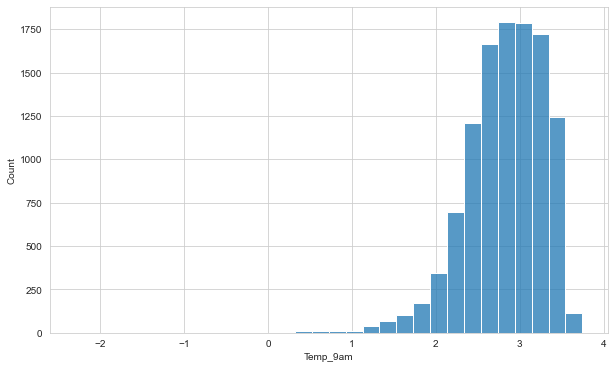

...

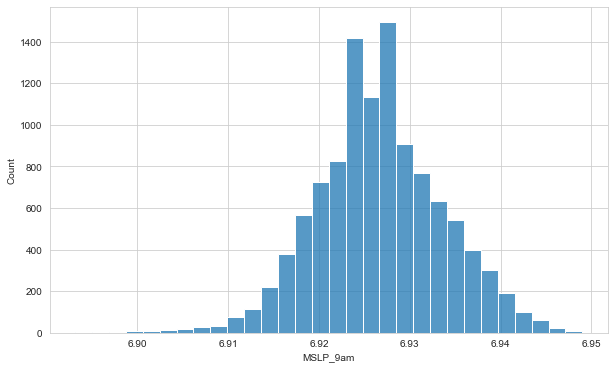

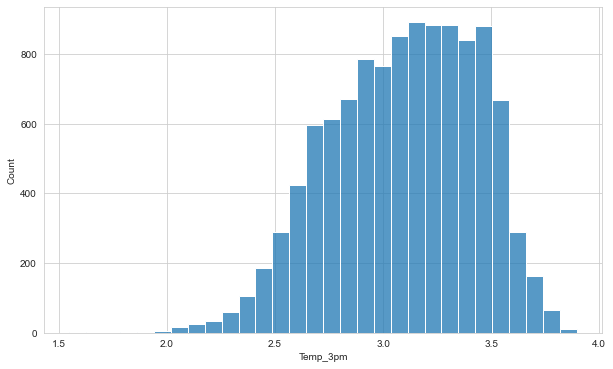

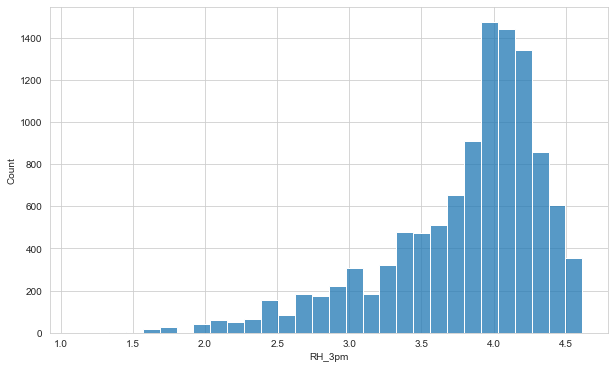

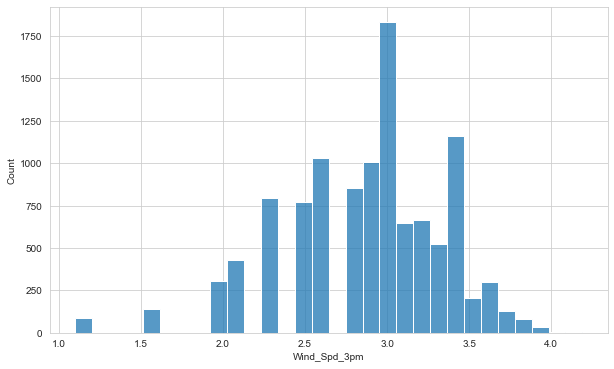

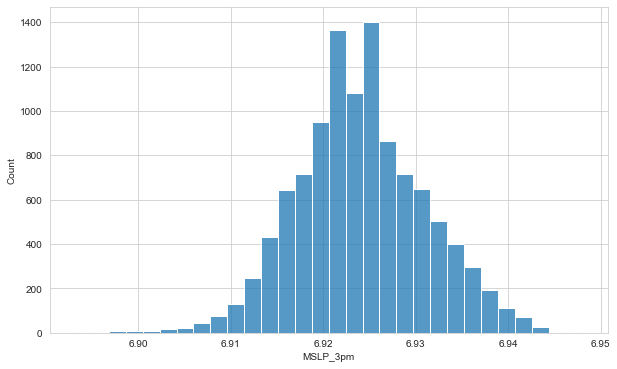

In [172]:
# We can print the histogram again for this features
# Plot the Outcome
for feature in interval:
    sns.set_style("whitegrid")
    plt.figure(figsize=(10,6))
    sns.histplot(x=feature, data=df_int_Log, bins=30)

3.- Categorical Transformations

In [173]:
# First we identify the features that are not on the interval list
categorical = []
for x in df_clean.columns:
    if x not in interval:
        categorical.append(x)

print(categorical)

# Now we will separate the features by Nominal and Ordinal that it will be required
nominal_cat = ["State", "Station", "Wind_Mx_Dir", "Wind_Dir_9am", "Wind_Dir_3pm", "Rain"]
ordinal_cat = ["Year", "Month", "Date", "Day", "Wind_Mx_Tim"]

df_clean[categorical]

['State', 'Station', 'Year', 'Month', 'Date', 'Day', 'Wind_Mx_Dir', 'Wind_Mx_Tim', 'Wind_Dir_9am', 'Wind_Dir_3pm', 'Rain']


,State,Station,Year,Month,Date,Day,Wind_Mx_Dir,Wind_Mx_Tim,Wind_Dir_9am,Wind_Dir_3pm,Rain
0,ACT,Canberra Airport {station 070351},2019,May,1.0,We,NNW,10.0,NNW,WNW,N
1,ACT,Canberra Airport {station 070351},2019,May,2.0,Th,NNW,15.0,ESE,NW,N
2,ACT,Canberra Airport {station 070351},2019,May,3.0,Fr,NNW,8.0,NNW,N,Y
3,ACT,Canberra Airport {station 070351},2019,May,4.0,Sa,SSE,18.0,Calm,WNW,Y
4,ACT,Canberra Airport {station 070351},2019,May,5.0,Su,S,15.0,S,S,N
...,...,...,...,...,...,...,...,...,...,...,...
11843,NT,Tennant Creek Airport {station 015135},2019,May,27.0,Mo,ESE,9.0,ESE,ESE,N
11844,NT,Tennant Creek Airport {station 015135},2019,May,28.0,Tu,ESE,7.0,ESE,E,N
11845,NT,Tennant Creek Airport {station 015135},2019,May,29.0,We,ESE,9.0,ESE,SE,N
11846,NT,Tennant Creek Airport {station 015135},2019,May,30.0,Th,ESE,10.0,ESE,SE,N


In [174]:
# Before transforming the features, I will make a copy from the clean data frame and we will work with a new transformed DF
df_cat_trans = df_clean[categorical].copy()

In [175]:
# We start with the Nominal features as is easier to encode
le = preprocessing.LabelEncoder()

# Transform categorical variables
for col in nominal_cat:
   df_cat_trans[col] = le.fit_transform(df_cat_trans[col])

In [176]:
# Now we need to create a dictionay for the Ordinal encoding categories
Wind_Mx_Tim = df_cat_trans[ordinal_cat].Wind_Mx_Tim.unique().tolist()
Wind_Mx_Tim.sort()

# Create dictionary
dictionry_ordinal = {
    "Month": [["January", "February", "March", "April", "May", "June", 
              "July", "August", "September", "October", "November", "December"]],
    "Day": [["Mo", "Tu", "We", "Th", "Fr", "Sa", "Su"]],
    "Year": [[2019, 2020]],
    "Date": [[i for i in range(1, 32)]],
    "Wind_Mx_Tim": [Wind_Mx_Tim]
    }


In [177]:
# Create a for loop that iterates 'dictionry_ordinal' and transform each column into ordinal type
for key, values in dictionry_ordinal.items():
  df_cat_trans[key] = OrdinalEncoder(categories=values).fit_transform(df_cat_trans[[key]])

In [178]:
# Let's have a look at our transformed DF
df_cat_trans

# We could ad a +1 if we don't want to include the 0 as value

,State,Station,Year,Month,Date,Day,Wind_Mx_Dir,Wind_Mx_Tim,Wind_Dir_9am,Wind_Dir_3pm,Rain
0,0,9,0.0,4.0,0.0,2.0,6,10.0,7,15,0
1,0,9,0.0,4.0,1.0,3.0,6,15.0,3,8,0
2,0,9,0.0,4.0,2.0,4.0,6,8.0,7,4,1
3,0,9,0.0,4.0,3.0,5.0,10,18.0,0,15,1
4,0,9,0.0,4.0,4.0,6.0,8,15.0,9,9,0
...,...,...,...,...,...,...,...,...,...,...,...
11843,2,22,0.0,4.0,26.0,0.0,2,9.0,3,3,0
11844,2,22,0.0,4.0,27.0,1.0,2,7.0,3,1,0
11845,2,22,0.0,4.0,28.0,2.0,2,9.0,3,10,0
11846,2,22,0.0,4.0,29.0,3.0,2,10.0,3,10,0


4.- Normalization

In [179]:
# Now we are goint to work again with our original Interval values, what we are going to do is to normalizae each of the features
# We create a new data frame that will be normalised
df_int_norm = df_clean[interval].copy()

In [180]:
# We will normalize using the Min-Max from a scale of [0, 1] 
min_max_scaler = preprocessing.MinMaxScaler()

# Loop to transform each feature
for col in df_int_norm:
    df_int_norm[col] = min_max_scaler.fit_transform(df_int_norm[[col]])

In [181]:
# Let's have a look at our Df 
df_int_norm

,Min_Temp,Max_Temp,Rain_mm,Wind_Mx_Spd,Temp_9am,RH_9am,Wind_Spd_9am,MSLP_9am,Temp_3pm,RH_3pm,Wind_Spd_3pm,MSLP_3pm
0,0.317949,0.349537,0.000000,0.262712,0.335632,0.791667,0.070175,0.662544,0.368539,0.602041,0.174603,0.661871
1,0.376923,0.418981,0.000000,0.203390,0.418391,0.833333,0.035088,0.743816,0.420225,0.561224,0.142857,0.683453
2,0.541026,0.340278,0.081633,0.347458,0.413793,0.989583,0.385965,0.611307,0.341573,0.744898,0.492063,0.562950
3,0.279487,0.307870,0.002355,0.330508,0.301149,0.812500,0.173860,0.593640,0.289888,0.459184,0.317460,0.559353
4,0.276923,0.270833,0.000000,0.389831,0.342529,0.635417,0.385965,0.644876,0.251685,0.571429,0.492063,0.627698
...,...,...,...,...,...,...,...,...,...,...,...,...
11843,0.605128,0.500000,0.000000,0.406780,0.503448,0.385417,0.543860,0.627208,0.507865,0.224490,0.380952,0.570144
11844,0.507692,0.423611,0.000000,0.389831,0.418391,0.364583,0.543860,0.646643,0.444944,0.204082,0.238095,0.584532
11845,0.443590,0.421296,0.000000,0.355932,0.429885,0.395833,0.421053,0.614841,0.433708,0.183673,0.285714,0.553957
11846,0.476923,0.395833,0.000000,0.332881,0.432184,0.395833,0.508772,0.644876,0.420225,0.255102,0.460317,0.597122


5.- Binning Data

In [182]:
# We are going to choose an Interval feature to convert to a categorical variable
# I'm goning to work with Temperatures
df_cat_temp = df_clean[["Min_Temp", "Max_Temp", "Temp_9am", "Temp_3pm"]].copy()

# I want the width of the ranges to be as close to 5C, for that we follow the formula: Width = (maximum value - minimum value) / N
for cat in df_cat_temp:
    bins = int(round((df_clean[cat].max() - df_clean[cat].min())/5, 0))
    df_cat_temp[cat] = pd.cut(df_clean[cat], bins, labels = False) # For ML labels = False

# Let's have a look
df_cat_temp

# For the propose of this part I'm leaving the data with integers as increasing value as this is now an oridnal feature

,Min_Temp,Max_Temp,Temp_9am,Temp_3pm
0,2,3,3,3
1,3,3,3,3
2,4,3,3,3
3,2,2,2,2
4,2,2,3,2
...,...,...,...,...
11843,4,4,4,4
11844,4,3,3,4
11845,3,3,3,3
11846,3,3,3,3


6.- Feature Selection

In [183]:
# First we need to join our categorical transformed DF to our normalized interval DF 
df_clean_trans = df_cat_trans.join(df_int_norm)

# Let's see what we have
df_clean_trans

,State,Station,Year,Month,Date,Day,Wind_Mx_Dir,Wind_Mx_Tim,Wind_Dir_9am,Wind_Dir_3pm,...,Rain_mm,Wind_Mx_Spd,Temp_9am,RH_9am,Wind_Spd_9am,MSLP_9am,Temp_3pm,RH_3pm,Wind_Spd_3pm,MSLP_3pm
0,0,9,0.0,4.0,0.0,2.0,6,10.0,7,15,...,0.000000,0.262712,0.335632,0.791667,0.070175,0.662544,0.368539,0.602041,0.174603,0.661871
1,0,9,0.0,4.0,1.0,3.0,6,15.0,3,8,...,0.000000,0.203390,0.418391,0.833333,0.035088,0.743816,0.420225,0.561224,0.142857,0.683453
2,0,9,0.0,4.0,2.0,4.0,6,8.0,7,4,...,0.081633,0.347458,0.413793,0.989583,0.385965,0.611307,0.341573,0.744898,0.492063,0.562950
3,0,9,0.0,4.0,3.0,5.0,10,18.0,0,15,...,0.002355,0.330508,0.301149,0.812500,0.173860,0.593640,0.289888,0.459184,0.317460,0.559353
4,0,9,0.0,4.0,4.0,6.0,8,15.0,9,9,...,0.000000,0.389831,0.342529,0.635417,0.385965,0.644876,0.251685,0.571429,0.492063,0.627698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11843,2,22,0.0,4.0,26.0,0.0,2,9.0,3,3,...,0.000000,0.406780,0.503448,0.385417,0.543860,0.627208,0.507865,0.224490,0.380952,0.570144
11844,2,22,0.0,4.0,27.0,1.0,2,7.0,3,1,...,0.000000,0.389831,0.418391,0.364583,0.543860,0.646643,0.444944,0.204082,0.238095,0.584532
11845,2,22,0.0,4.0,28.0,2.0,2,9.0,3,10,...,0.000000,0.355932,0.429885,0.395833,0.421053,0.614841,0.433708,0.183673,0.285714,0.553957
11846,2,22,0.0,4.0,29.0,3.0,2,10.0,3,10,...,0.000000,0.332881,0.432184,0.395833,0.508772,0.644876,0.420225,0.255102,0.460317,0.597122


In [184]:
# First let's run a correlation analysis and find the top absolute values
df_clean_trans.corr()["Rain"].abs().sort_values(ascending=False)



Rain            1.000000
RH_9am          0.413203
RH_3pm          0.399341
Rain_mm         0.351431
Temp_3pm        0.313225
Max_Temp        0.309128
Temp_9am        0.198578
Wind_Dir_9am    0.177763
Wind_Mx_Dir     0.176471
Wind_Dir_3pm    0.159442
MSLP_9am        0.112135
Month           0.111335
Wind_Mx_Spd     0.101627
Year            0.072044
State           0.065846
Wind_Mx_Tim     0.064459
Min_Temp        0.061662
Wind_Spd_3pm    0.048957
Date            0.037403
Wind_Spd_9am    0.036350
MSLP_3pm        0.029655
Station         0.024133
Day             0.010318
Name: Rain, dtype: float64

In [185]:
# Now we are going to use the SKB feature selection
# First we need to separate the DF on X, y
X = df_clean_trans.drop("Rain", axis=1)
y = df_clean_trans["Rain"]

# Initialise the SelectKBest, for this case we will use the chi2
skb =  SelectKBest(score_func=chi2, k="all")

# Fit the SelectKBest
skb_chi2 = skb.fit(X, y)

# Get the features in a data fram
feat_imp_skb_chi2 = pd.DataFrame(
    {'feature': X.columns[skb_chi2.get_support()].values,
     'importance': skb_chi2.scores_
     }
     )

# See results
feat_imp_skb_chi2.sort_values('importance', ascending=False)

,feature,importance
8,Wind_Dir_9am,974.846717
6,Wind_Mx_Dir,969.308077
9,Wind_Dir_3pm,702.129678
3,Month,265.730688
12,Rain_mm,180.067016
19,RH_3pm,173.246742
15,RH_9am,144.822392
7,Wind_Mx_Tim,87.892406
4,Date,80.833174
11,Max_Temp,78.622673


In [186]:
# Now we will use the mutual_info_classif
skb =  SelectKBest(score_func=mutual_info_classif, k="all")

# Fit the SelectKBest
skb_mutual_info =  skb.fit(X, y)

# Get the features in a data fram
feat_imp_skb_Minf = pd.DataFrame(
    {'feature': X.columns[skb_mutual_info.get_support()].values,
     'importance': skb_mutual_info.scores_
     }
     )

# See results
feat_imp_skb_Minf.sort_values('importance', ascending=False)

,feature,importance
12,Rain_mm,0.607769
15,RH_9am,0.106863
19,RH_3pm,0.096918
18,Temp_3pm,0.055578
11,Max_Temp,0.054536
1,Station,0.029328
14,Temp_9am,0.028067
9,Wind_Dir_3pm,0.024357
0,State,0.024132
8,Wind_Dir_9am,0.021669


In [187]:
# From the last two SKB selections, we can see that:
# chi2 is better at getting the categorical features
# mutual_info_classif is better at getting the interval features

# I'm going to use a different option by running a Decision Tree and finding which featrues it selecs
clf = DecisionTreeClassifier()
selector = SelectFromModel(clf, threshold='median')
selector.fit(X, y)

# Get the features in a data fram
feat_imp_fromMod = pd.DataFrame(
    {'feature': X.columns,
     'importance': selector.estimator_.feature_importances_
     }
     )

# More of a mix, but this is what it will be suitable for a Decision Tree model, if we use a different model different features will be selected
feat_imp_fromMod

,feature,importance
0,State,0.000084
1,Station,0.002335
2,Year,0.000000
3,Month,0.000414
4,Date,0.000224
5,Day,0.000977
6,Wind_Mx_Dir,0.000217
7,Wind_Mx_Tim,0.000000
8,Wind_Dir_9am,0.000000
9,Wind_Dir_3pm,0.000000


7.- Scattered Plots

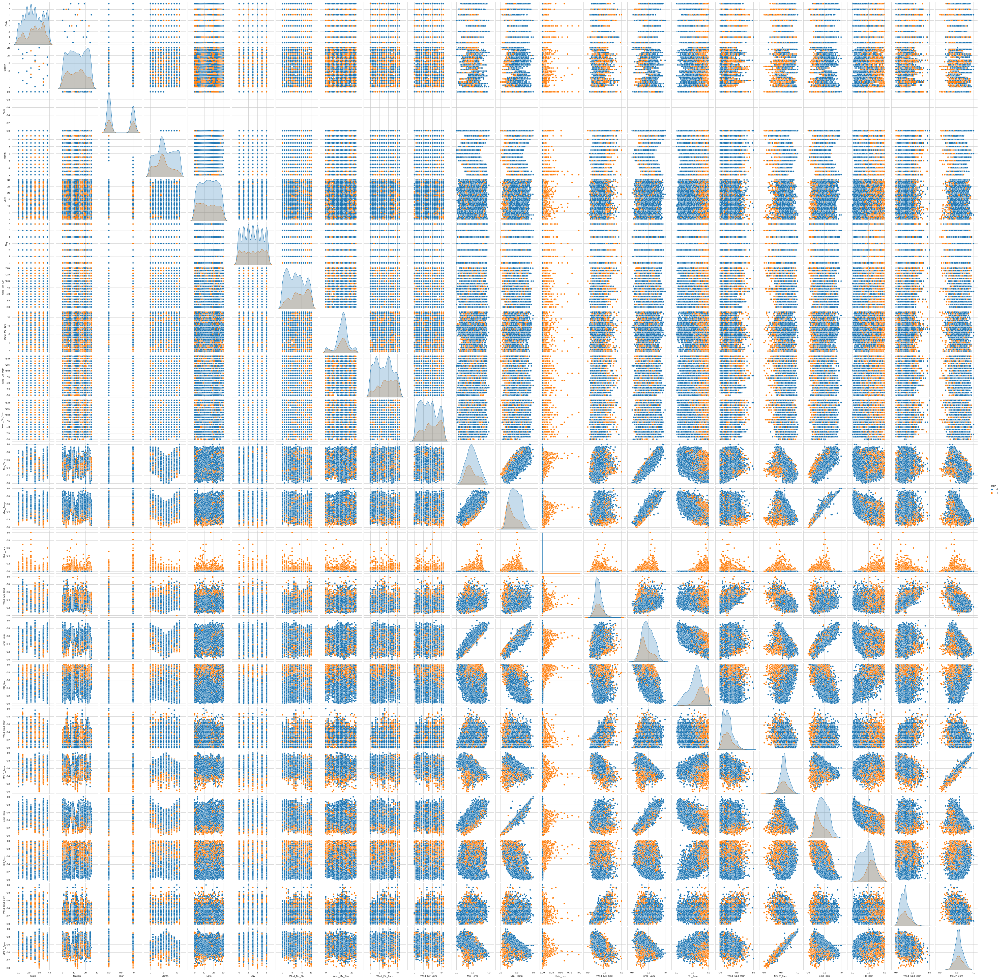

In [188]:
# First we are going to plot all features and try to identify the more relevant 
sns.pairplot(df_clean_trans, hue='Rain')

In [189]:
# First we are going to choose the top 3 and bottom 3 features from the "Mutual_Info_Clasifier"
top3_bot3 = feat_imp_skb_Minf.sort_values('importance', ascending=False).feature.values[[0,1,2,-3,-2,-1]].tolist()

# We add Rain as outcome
top3_bot3.append("Rain")

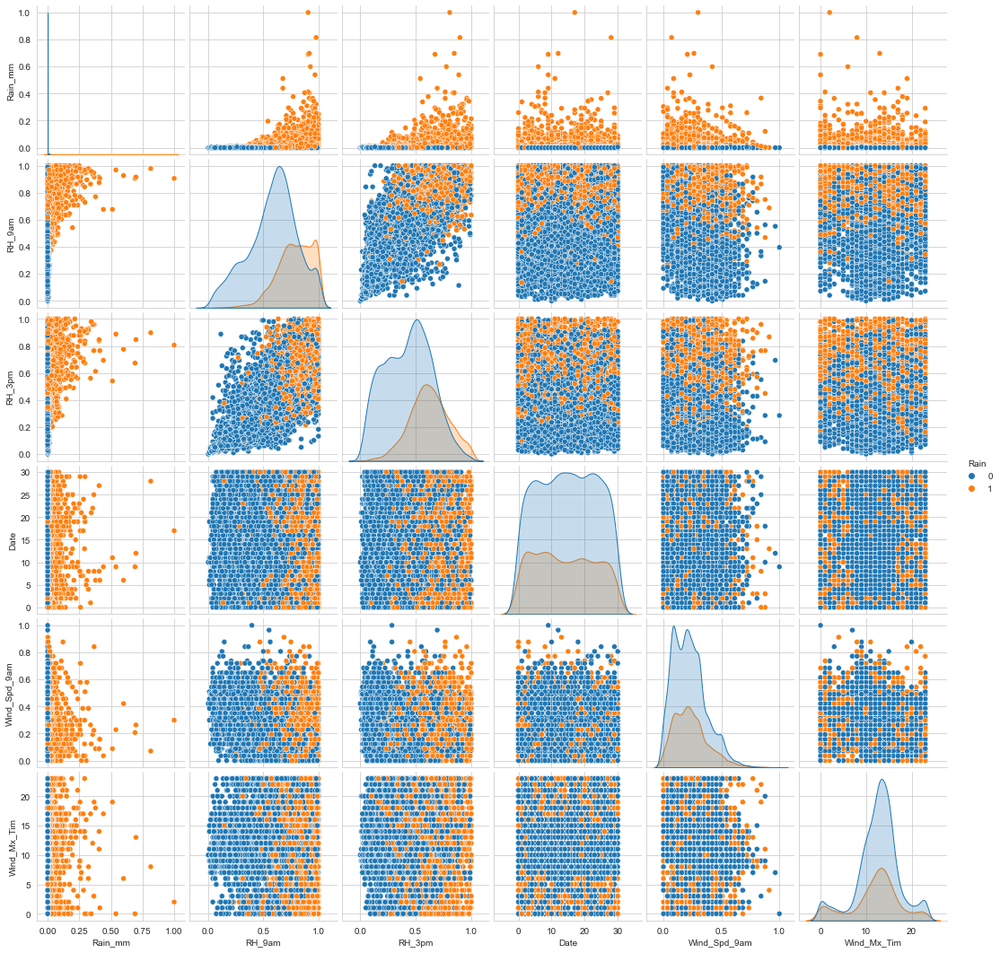

In [190]:
# Create a Scatter plot for the top 3 and bottom 3 features from our previous selection
sns.pairplot(df_clean_trans[top3_bot3], hue='Rain')

8.- Correlation Map

<AxesSubplot:>

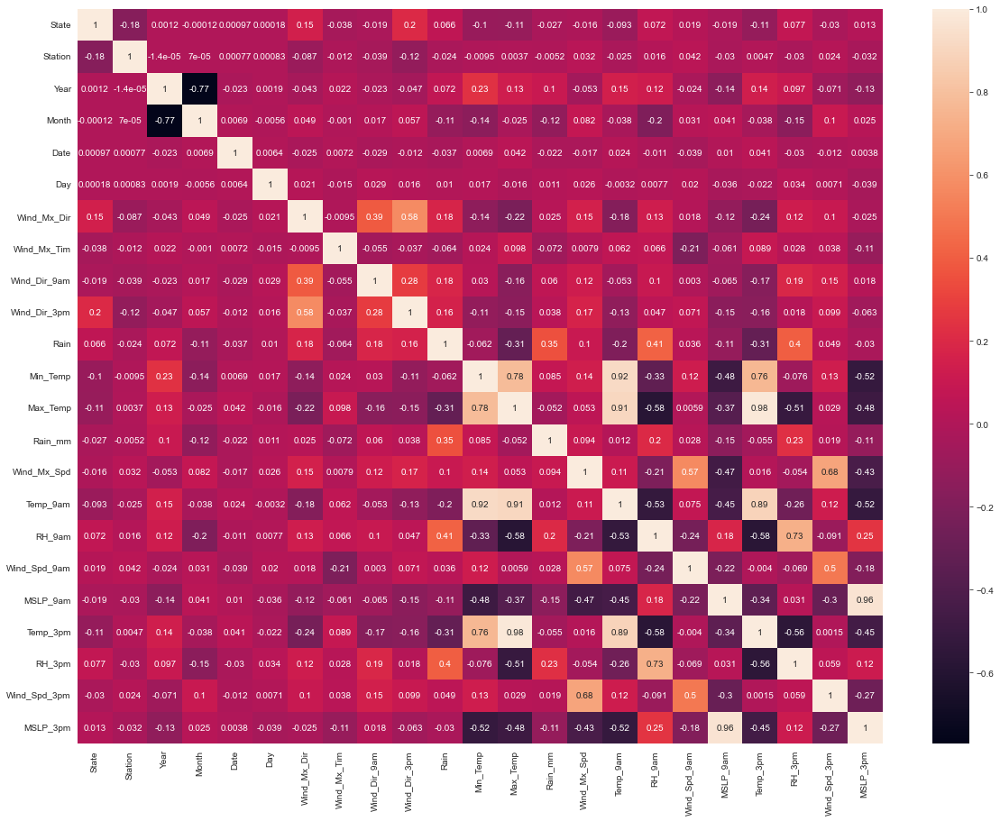

In [191]:
# Correlation among variables
plt.figure(figsize=(20,15))
sns.heatmap(df_clean_trans.corr(), annot=True)

9.- Export Data 

In [192]:
# First we need the categorical features we created from the interval range.
# I'm leaving this features with the binning range as values 
df_clean_trans = df_clean_trans.join(df_cat_temp.add_suffix("_cat"))

# Now we save the clean DF
df_clean_trans.to_csv("ManuelAlvarez_Project1.csv", index=True)

PART 2 - SPLIT DATA 

In [193]:
# First we create a copy of the clean data as the new DF, we are not going to include the binned features
df = df_clean_trans.iloc[:,:-4].copy()

In [194]:
# Check distribution of target variable
df["Rain"].value_counts(normalize=True)


0    0.701718
1    0.298282
Name: Rain, dtype: float64

In [195]:
# Check distribution of State variable
df["State"].value_counts(normalize=True)

4    0.154049
3    0.153776
6    0.153413
5    0.115968
2    0.115877
7    0.115423
1    0.114969
0    0.076525
Name: State, dtype: float64

In [196]:
# Split the data on X and y
X = df.drop("Rain", axis=1)
y = df["Rain"]

In [197]:
# Split the data to Test and Stratify on the target
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

In [198]:
# Check the distribution of targets
y_test.value_counts(normalize=True)

0    0.701563
1    0.298437
Name: Rain, dtype: float64

In [199]:
# Check the distribution of States
X_test["State"].value_counts(normalize=True)

# it look really close to original, no need to stratify on the split

3    0.165031
6    0.158124
4    0.150491
7    0.121410
2    0.114140
5    0.111232
1    0.109778
0    0.069793
Name: State, dtype: float64

In [200]:
# Splitt to validation set 
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.25, random_state=42, stratify=y_temp)

In [201]:
# Check distributions of targets
print(y_train.value_counts(normalize=True))
print(y_val.value_counts(normalize=True))

0    0.701729
1    0.298271
Name: Rain, dtype: float64
0    0.70189
1    0.29811
Name: Rain, dtype: float64


In [202]:
# check the shape of each DF 
print("Training:", X_train.shape)
print("Validation:", X_val.shape)
print("Testing:", X_test.shape)


Training: (6189, 22)
Validation: (2063, 22)
Testing: (2751, 22)


Demo Data Set

In [203]:
# Creating a demo data set with a size of 20 samples
X_train, X_demo, y_train, y_demo = train_test_split(X_train, y_train, test_size=20, random_state=42, stratify=y_train)

In [204]:
# Distribution of the demo data set
y_demo.value_counts(normalize=True)

0    0.7
1    0.3
Name: Rain, dtype: float64

In [205]:
# DF shapes
print("Training:", X_train.shape)
print("Demo Data:", X_demo.shape)

Training: (6169, 22)
Demo Data: (20, 22)


PART 3 - FEATURE SIZE SELECTION

In [206]:
# In part 1 we look at three different techniques for choosing the most relevant features, now I want to investigate the number of features we need
# For this we will use the the function SelectKBest with mutual_info_classif
skb =  SelectKBest(score_func=mutual_info_classif, k="all")

# Fit the SelectKBest
skb_mutual_info =  skb.fit(X_train, y_train)

# Get the features in a data fram
feat_imp_skb_Minf = pd.DataFrame(
    {'feature': X.columns[skb_mutual_info.get_support()].values,
     'importance': skb_mutual_info.scores_
     }
     )

# See results
feat_imp_skb_Minf = feat_imp_skb_Minf.sort_values('importance', ascending=False).reset_index().drop("index", axis= 1)


In [207]:
# Now I will fit each model with the default parameters and see how the accuracy increases by adding more features, we will compare this and from here, 
# Start working independently on each model with the same features and number for all of them
knn = KNeighborsClassifier()
clf = DecisionTreeClassifier()
log_reg = LogisticRegression()
svc = svm.SVC()

# create a dictionary to store our scores
model_features_scores = {"features": [],
                         "model": [],
                         "score": []}

# Loop true each model 
for model in [knn, clf, log_reg, svc]:
    for i in range(2, len(feat_imp_skb_Minf) + 1):
        model.fit(X_train[feat_imp_skb_Minf.feature[:i].values], y_train)
        y_pred = model.predict(X_val[feat_imp_skb_Minf.feature[:i].values])
        model_features_scores["features"].append(i)
        model_features_scores["model"].append(model)
        model_features_scores["score"].append(accuracy_score(y_val, y_pred))

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [208]:
# Convert the results to a DF 
model_features_scores = pd.DataFrame(model_features_scores)

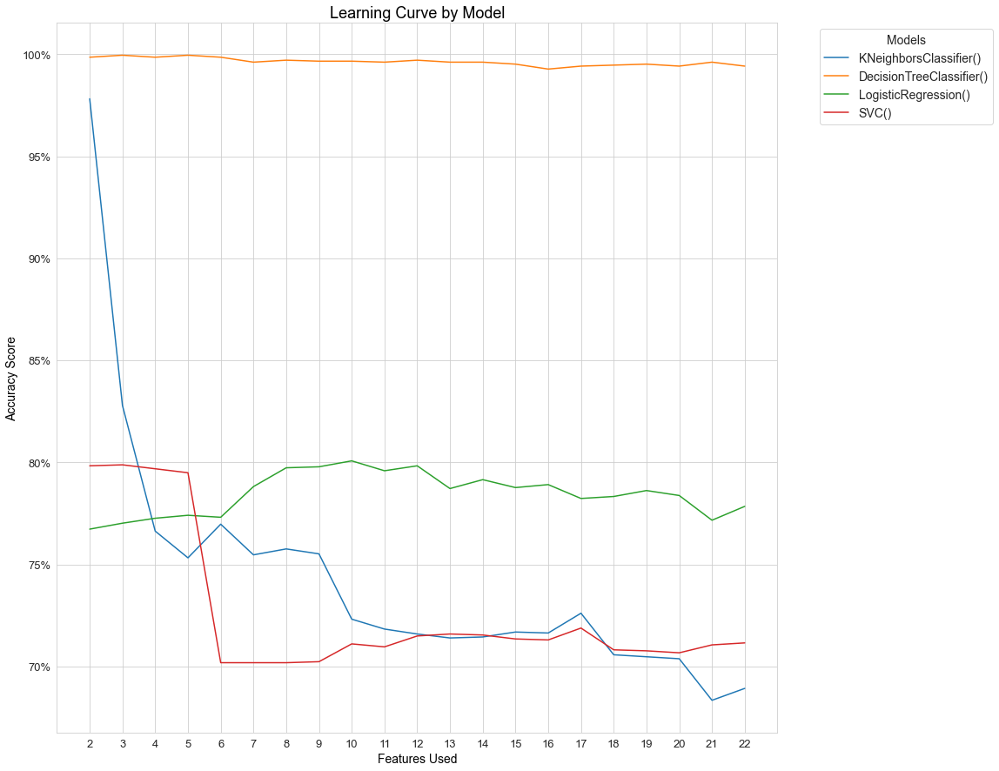

In [209]:
# Visualize the Results
plt.figure(figsize=(20,15))
sns.lineplot(x = model_features_scores["features"], y = model_features_scores["score"], hue = model_features_scores["model"])
plt.xticks(range(2, 23), fontsize=13)
plt.yticks(fontsize=13)
yticks = mtick.PercentFormatter(xmax=1, decimals=0, symbol='%')
plt.gca().yaxis.set_major_formatter(yticks)
plt.ylabel('Accuracy Score', fontsize=14, color='black')
plt.xlabel('Features Used', fontsize=14, color='black')
plt.title('Learning Curve by Model', fontsize=18, color='black')
legend = plt.legend(title='Models', fontsize=14)
legend.get_title().set_fontsize(14)
legend.set_bbox_to_anchor((1.05, 1))
plt.subplots_adjust(right=0.7)

In [210]:
# Choose the top 6 features
top6_features = feat_imp_skb_Minf.feature[:6].values
top6_features

array(['Rain_mm', 'RH_9am', 'RH_3pm', 'Temp_3pm', 'Max_Temp', 'Station'],
      dtype=object)

PART 4 - KNN

4.1 - Choose Parameters

In [211]:
# We are going to look at the number of ideal neighbours and the best distance measurment, using the 6 features 
metrics = ["euclidean", "manhattan"]

# Create a dictionary to save results
knn_parameters = {"metric": [],
                  "k_values": [],
                  "Accuracy": []}

for metric in metrics:
    for n in range(3, 60, 2):
        knn = KNeighborsClassifier(n_neighbors=n, metric=metric)
        knn.fit(X_train[top6_features], y_train)
        y_pred = knn.predict(X_val[top6_features])
        knn_parameters["metric"].append(metric)
        knn_parameters["k_values"].append(n)
        knn_parameters["Accuracy"].append(accuracy_score(y_pred, y_val))

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [212]:
# Convert to Data Frame to see results
knn_parameters = pd.DataFrame(knn_parameters)

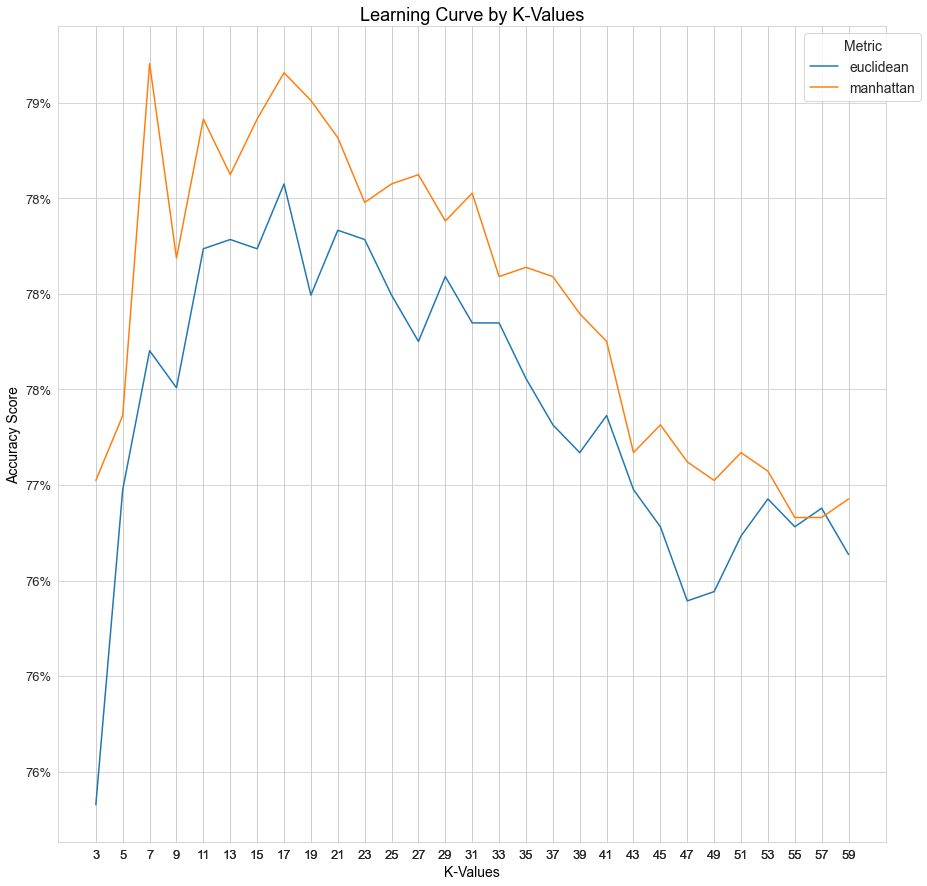

In [213]:
# Visualize the Results
plt.figure(figsize=(20,15))
sns.lineplot(x = knn_parameters["k_values"], y = knn_parameters["Accuracy"], hue = knn_parameters["metric"])
plt.xticks(knn_parameters["k_values"], fontsize=13)
plt.yticks(fontsize=13)
yticks = mtick.PercentFormatter(xmax=1, decimals=0, symbol='%')
plt.gca().yaxis.set_major_formatter(yticks)
plt.ylabel('Accuracy Score', fontsize=14, color='black')
plt.xlabel('K-Values', fontsize=14, color='black')
plt.title('Learning Curve by K-Values', fontsize=18, color='black')
legend = plt.legend(title='Metric', fontsize=14)
legend.get_title().set_fontsize(14)
legend.set_bbox_to_anchor((1.05, 1))
plt.subplots_adjust(right=0.7)

4.2 Rethinking Number of Features

In [214]:
# From the intial feature search we saw that only including 2 features generated a greater accuracy, lets test that with the top 6 and general parameters
knn = KNeighborsClassifier()

score = {}
for i in range(2,7):
    knn.fit(X_train[top6_features[:i]], y_train)
    y_pred = knn.predict(X_val[top6_features[:i]])
    score[i] = (accuracy_score(y_pred, y_val))

score

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

{2: 0.9781871061560834,
 3: 0.8279205041202132,
 4: 0.7663596703829375,
 5: 0.7532719340765875,
 6: 0.7697527872031023}

In [215]:
knn.get_params()

{'algorithm': 'auto',
 'leaf_size': 30,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': None,
 'n_neighbors': 5,
 'p': 2,
 'weights': 'uniform'}

In [216]:
# What if we use "RH_3pm"
nn = KNeighborsClassifier()
knn.fit(X_train[["Rain_mm", "RH_3pm"]], y_train)
y_pred = knn.predict(X_val[["Rain_mm", "RH_3pm"]])
accuracy_score(y_pred, y_val)

# Not a better score

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


0.9743092583616093

4.3 Parameter Search for Two Features

In [217]:
# Finne tunning the mode with only top two features 
metrics = ["euclidean", "manhattan"]

# Create a dictionary to save results
knn_parameters = {"metric": [],
                  "k_values": [],
                  "Accuracy": []}

for metric in metrics:
    for n in range(3, 60, 2):
        knn = KNeighborsClassifier(n_neighbors=n, metric=metric)
        knn.fit(X_train[top6_features[:2]], y_train)
        y_pred = knn.predict(X_val[top6_features[:2]])
        knn_parameters["metric"].append(metric)
        knn_parameters["k_values"].append(n)
        knn_parameters["Accuracy"].append(accuracy_score(y_pred, y_val))

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

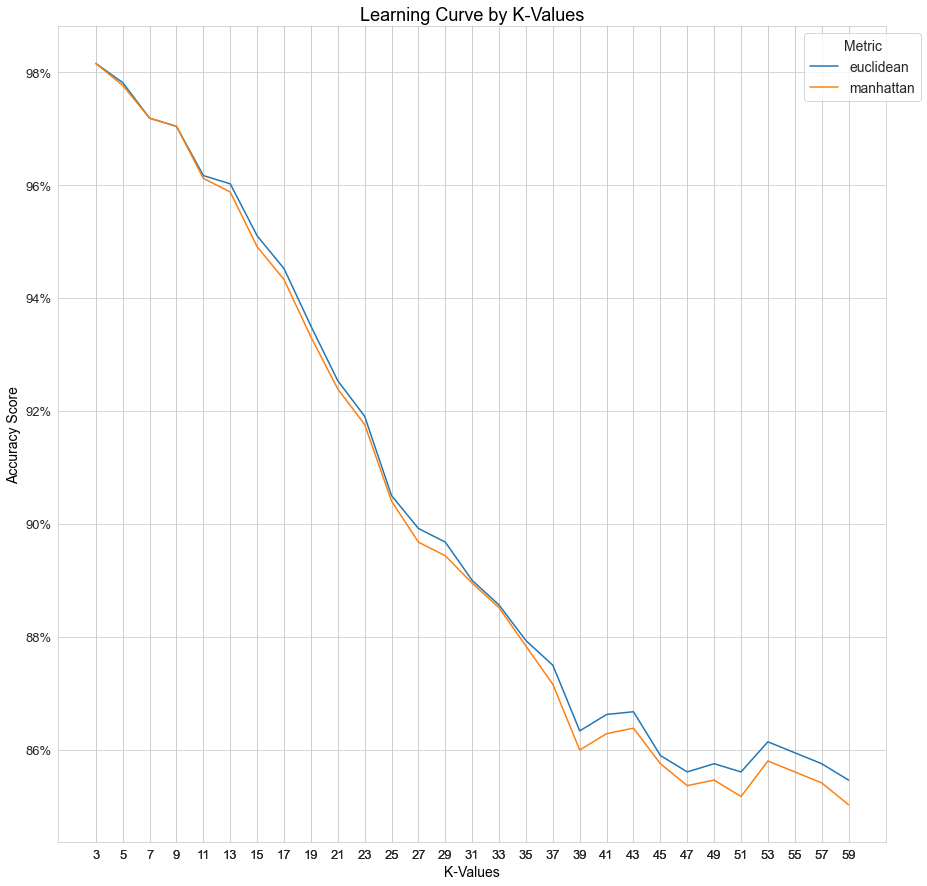

In [218]:
# Visualize the Results
plt.figure(figsize=(20,15))
sns.lineplot(x = knn_parameters["k_values"], y = knn_parameters["Accuracy"], hue = knn_parameters["metric"])
plt.xticks(knn_parameters["k_values"], fontsize=13)
plt.yticks(fontsize=13)
yticks = mtick.PercentFormatter(xmax=1, decimals=0, symbol='%')
plt.gca().yaxis.set_major_formatter(yticks)
plt.ylabel('Accuracy Score', fontsize=14, color='black')
plt.xlabel('K-Values', fontsize=14, color='black')
plt.title('Learning Curve by K-Values', fontsize=18, color='black')
legend = plt.legend(title='Metric', fontsize=14)
legend.get_title().set_fontsize(14)
legend.set_bbox_to_anchor((1.05, 1))
plt.subplots_adjust(right=0.7)

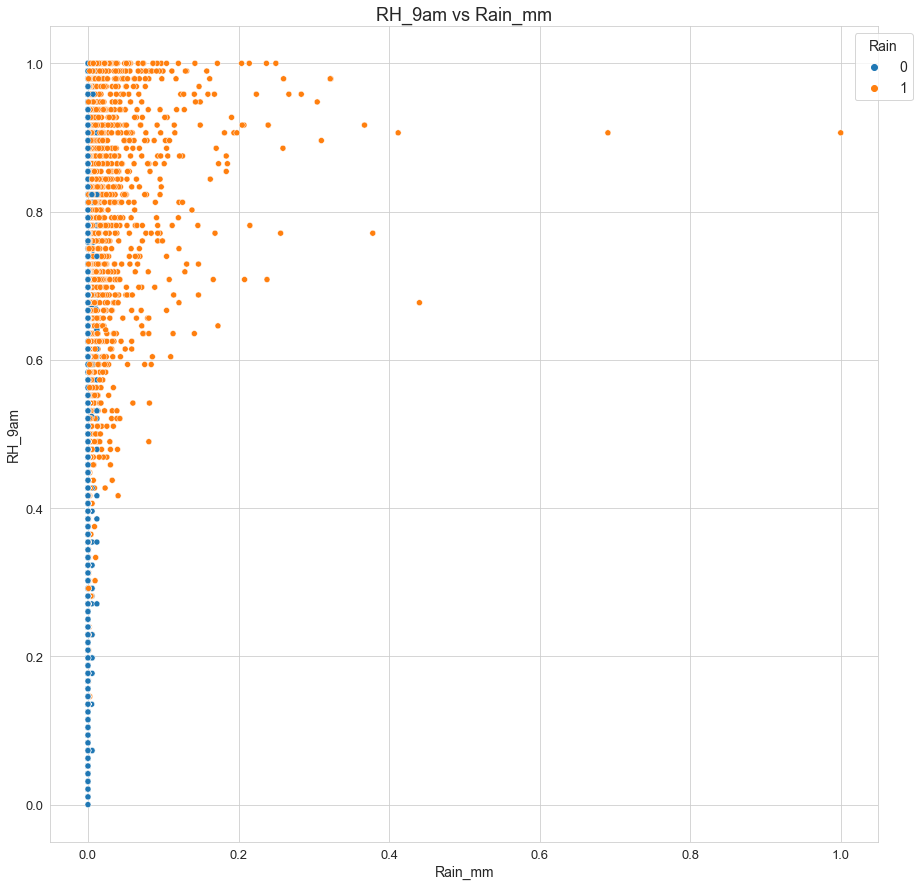

In [219]:
# Visual evidence of why it works with only top 2 features
plt.figure(figsize=(20,15))
sns.scatterplot(x = "Rain_mm", y="RH_9am", hue='Rain', data = X_train[top6_features[:2]].join(y_train))
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.ylabel("RH_9am", fontsize=14)
plt.xlabel("Rain_mm", fontsize=14)
plt.title('RH_9am vs Rain_mm', fontsize=18)
legend = plt.legend(title='Rain', fontsize=14)
legend.get_title().set_fontsize(14)
legend.set_bbox_to_anchor((1.05, 1))
plt.subplots_adjust(right=0.7)

4.4 Testing the Model 

In [220]:
# We found that the best scoring model on the validation is with the top 2 featues, 3 neighbours and any metric will be ok
knn = KNeighborsClassifier(n_neighbors=3, metric="euclidean")
knn.fit(X_train[top6_features[:2]], y_train)
y_pred = knn.predict(X_test[top6_features[:2]])

print(f"Testing Accuracy: {accuracy_score(y_pred, y_test).round(5) * 100}%")

Testing Accuracy: 97.637%


c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


4.5 Visualising the Result

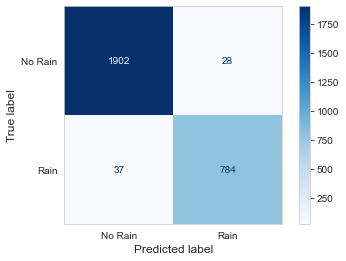

In [221]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

In [222]:
# Classification Report
print(classification_report(y_test, y_pred))
print(balanced_accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.99      0.98      1930
           1       0.97      0.95      0.96       821

    accuracy                           0.98      2751
   macro avg       0.97      0.97      0.97      2751
weighted avg       0.98      0.98      0.98      2751

0.9702126182527311


PART 5 - REGRESSION

5.1 - Parameter Tunning

In [223]:
# We saw in the first plot that after 6 features we didn't have much of an improvement, now we will look for Parameters
# The following will be the parameters

parameters = {
    'C': [0.1, 1, 5, 10],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
} 


In [224]:
# As we have various parameters that don't allow to visualize, we are going to use GridSearchCV
log_reg = LogisticRegression()

# Run the search
grid_search = GridSearchCV(log_reg, parameters, cv=5)
grid_search.fit(X_train[top6_features], y_train)

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter 

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [0.1, 1, 5, 10], 'penalty': ['l1', 'l2'],
                         'solver': ['liblinear', 'saga']})

In [225]:
# Look at the results 
print("Parameters: ", grid_search.best_params_)
print("Score: ", grid_search.best_score_)

# Results
# Parameters:  {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
# Score:  0.8986872355444089

Parameters:  {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
Score:  0.8973907705573761


5.2 Testing the Model 

In [226]:
# We found that the best scoring model on the validation is with the top 2 featues, 3 neighbours and any metric will be ok
log_reg = LogisticRegression(C=10, penalty='l1', solver='liblinear')
log_reg.fit(X_train[top6_features], y_train)
y_pred = log_reg.predict(X_test[top6_features])

print(f"Testing Accuracy: {accuracy_score(y_pred, y_test).round(5) * 100}%")

Testing Accuracy: 90.03999999999999%


5.3 Visualising the Result

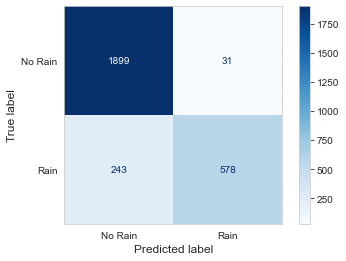

In [227]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

In [228]:
# Classification Report
print(classification_report(y_test, y_pred))
print(balanced_accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.89      0.98      0.93      1930
           1       0.95      0.70      0.81       821

    accuracy                           0.90      2751
   macro avg       0.92      0.84      0.87      2751
weighted avg       0.91      0.90      0.90      2751

0.8439786561314712


PART 6 - DECISION TREE

6.1 First Hyperparametres tunning 

In [229]:
# Now we are going to work with our decision tree, from the initial plot we can see that it can easily overfit the model, we are going to use the GridsearchCV
# But in this case we will keep a small tree
parametres = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 3, 4],
    'max_leaf_nodes': [2, 6, 8],
    'min_samples_leaf': [50, 75, 100],
}

# I'm playing careful for not overfitting the tree, I also want to start mellow and see what happnes 

In [230]:
# Now we test the parametres
d_tree = DecisionTreeClassifier()

# Start the Gridsearch
grid_search = GridSearchCV(d_tree, parametres, cv=5)
grid_search.fit(X_train[top6_features], y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 4], 'max_leaf_nodes': [2, 6, 8],
                         'min_samples_leaf': [50, 75, 100]})

In [231]:
# Look at the results 
print("Parameters: ", grid_search.best_params_)
print("Score: ", grid_search.best_score_)

# Results
# Parameters:  {'criterion': 'gini', 'max_depth': 2, 'max_leaf_nodes': 2, 'min_samples_leaf': 50}
# Score:  0.9847634145283471

Parameters:  {'criterion': 'gini', 'max_depth': 2, 'max_leaf_nodes': 2, 'min_samples_leaf': 50}
Score:  0.9847634145283471


6.2 Tree Visualisation

In [232]:
# We fit the tree with the parametres 
d_tree_simple = DecisionTreeClassifier(criterion= 'gini', max_depth = 2, max_leaf_nodes= 2, min_samples_leaf= 50)
d_tree_simple.fit(X_train[top6_features], y_train)

DecisionTreeClassifier(max_depth=2, max_leaf_nodes=2, min_samples_leaf=50)

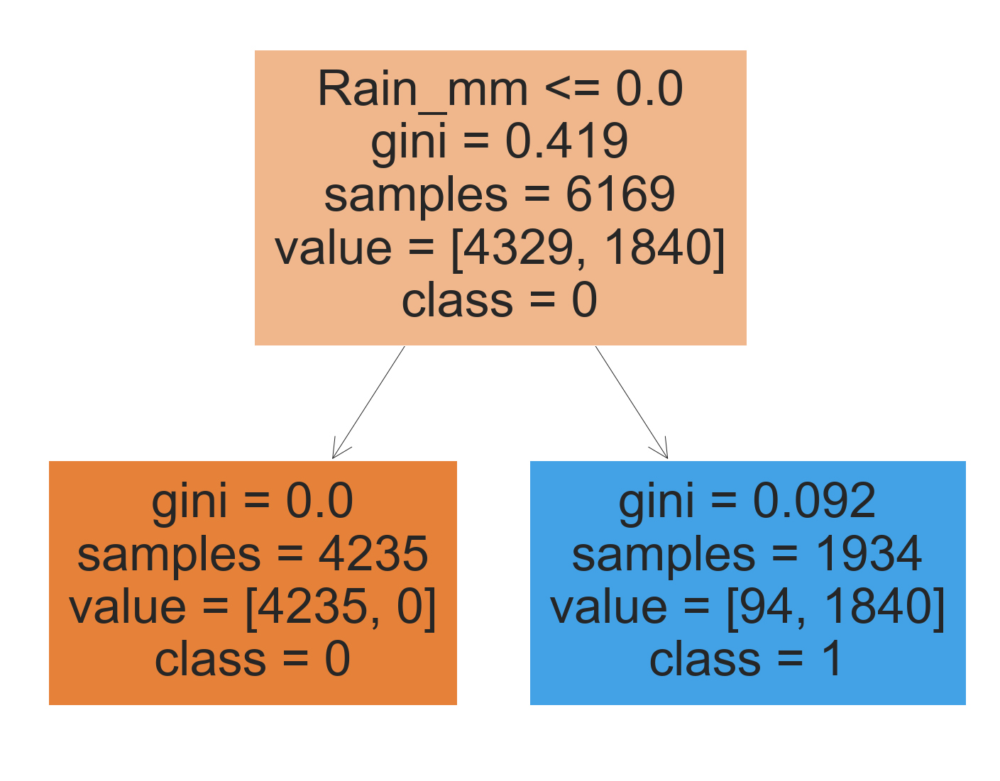

In [233]:
# We get a result
tree_fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(d_tree_simple, feature_names= list(X_train[top6_features].columns), class_names=['0', '1'], filled=True)

6.3 Continue Parametre Tunning

In [234]:
# In the last tree we only used one feature, Rain mm, by looking at the diagram we can see that 94 samples will be incorrectly label as raining.
# I will try a more advance tree and I will start working with the Validation set

parametres = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 4, 6, 8],
    'max_leaf_nodes': [6, 8, 10, 12],
}

# Now we test the parametres
d_tree_complx = DecisionTreeClassifier()

# Start the Gridsearch
grid_search = GridSearchCV(d_tree_complx, parametres, cv=5)
grid_search.fit(X_train[top6_features], y_train)

# Look at the results 
print("Parameters: ", grid_search.best_params_)
print("Score: ", grid_search.best_score_)

Parameters:  {'criterion': 'entropy', 'max_depth': 8, 'max_leaf_nodes': 12}
Score:  0.9993514388881659


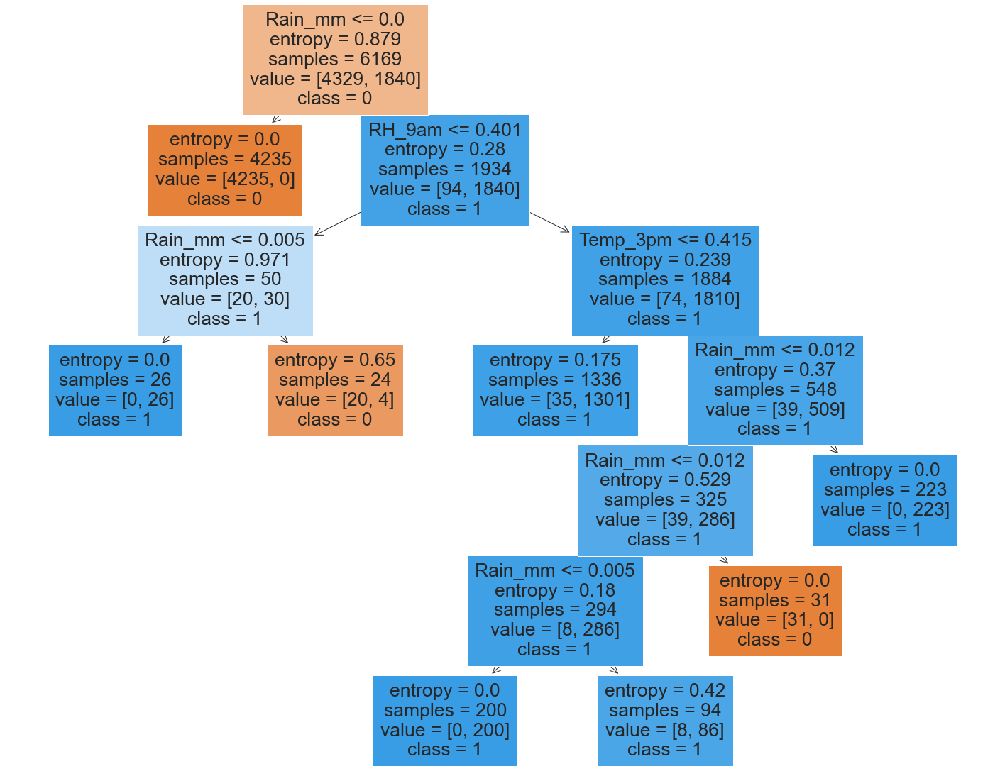

In [235]:
# We fit the tree with the parametres 
d_tree_complx = DecisionTreeClassifier(criterion= 'entropy', max_depth = 8, max_leaf_nodes= 8, max_features = 3)
d_tree_complx.fit(X_train[top6_features], y_train)



# We get a result
tree_fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(d_tree_complx, feature_names= list(X_train[top6_features]), class_names=['0', '1'], filled=True)


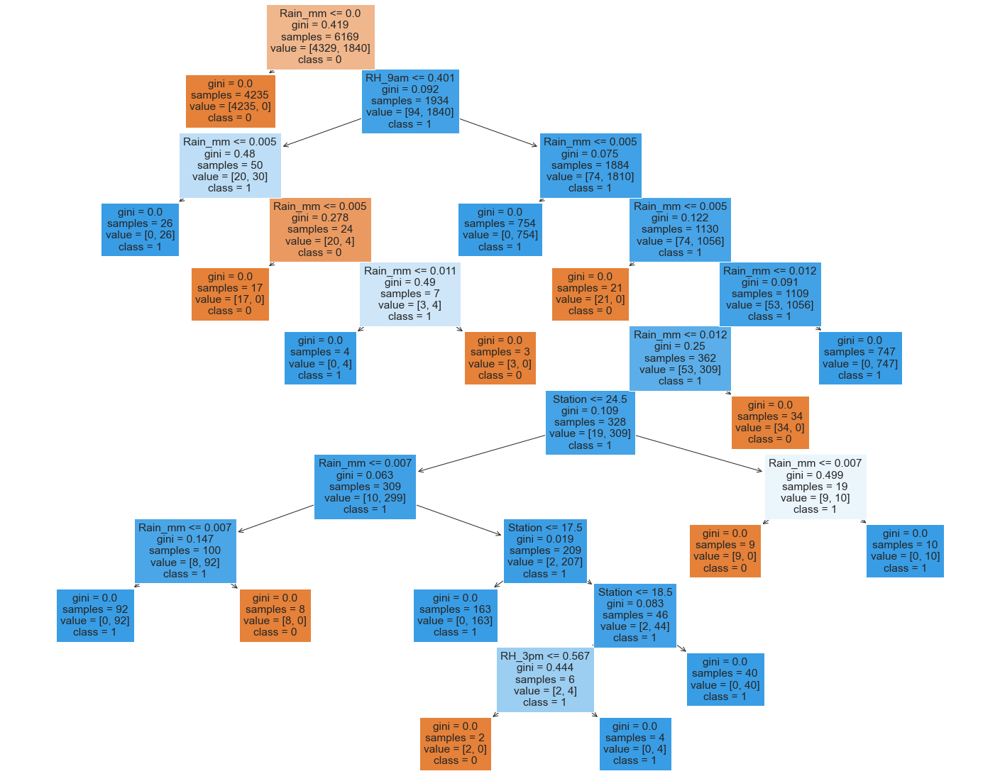

In [236]:
# We fit the tree with the parametres 
d_tree_def = DecisionTreeClassifier()
d_tree_def.fit(X_train[top6_features], y_train)


# We get a result
tree_fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(d_tree_def, feature_names= list(X_train[top6_features].columns), class_names=['0', '1'], filled=True)

In [237]:
# Defualt decision tree params
d_tree_def.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

In [238]:
# Compare simple vs complex (not to complex) vs default settings (probably overfitting)
print("Simple:", accuracy_score(y_val, d_tree_simple.predict(X_val[top6_features])))
print("Complex:", accuracy_score(y_val, d_tree_complx.predict(X_val[top6_features])))
print("Derfault:", accuracy_score(y_val, d_tree_def.predict(X_val[top6_features])))

# We can see that the inital tree is giving a relatively good score of 98.64% better than the 70% baseline and any previous model, we have a better score on the other trees,
# But we can see that is overfitting on the Rain_mm variable, I tried to work with the max_features variable but I couldn't get a better score than the simple tree 
# I also experimented with a tree with no Rain_mm and we can't get much better than 75%, which is just to close to the baseline. 

Simple: 0.9864275327193408
Complex: 0.9922443044110518
Derfault: 0.9975763451284537


6.4 Testing the Model 

In [239]:
# I will use the simplest tree for the testing
d_tree = DecisionTreeClassifier(criterion= 'gini', max_depth = 2, max_leaf_nodes= 2, min_samples_leaf= 50)
d_tree.fit(X_train[top6_features], y_train)
y_pred = d_tree.predict(X_test[top6_features])

print(f"Testing Accuracy: {accuracy_score(y_pred, y_test).round(4) * 100}%")

Testing Accuracy: 98.58%


6.5 Visualising the Result

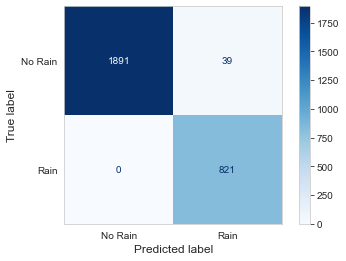

In [240]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

In [241]:
# Classification Report
print(classification_report(y_test, y_pred))
print(balanced_accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      1930
           1       0.95      1.00      0.98       821

    accuracy                           0.99      2751
   macro avg       0.98      0.99      0.98      2751
weighted avg       0.99      0.99      0.99      2751

0.9898963730569947


In [242]:
# Choose the number of features
top6_features = ['Rain_mm', 'RH_9am', 'RH_3pm', 'Temp_3pm', 'Max_Temp', 'Temp_9am']

PART 7 - SVM

7.1 Parametre Tunning

In [243]:
# We are going to work with the top 6 features and use GridsearchCV to find the best parametres
parametres = {
    #'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    #'gamma': [0.1, 1, 10],
    'degree': [3,4],
    #'class_weight': [None, 'balanced']
}

# Now we test the parametres
#svc = svm.SVC(kernel="poly")

# Start the Gridsearch
#grid_search = GridSearchCV(svc, parametres, cv=5)
#grid_search.fit(X_train[top6_features], y_train)

# Now I get to enjoy some waiting time

In [244]:
# Look at the results 
#print("Parameters: ", grid_search.best_params_)
#print("Score: ", grid_search.best_score_)


# Best result
# Score:  0.8923654077956152
# If I increase to degree 4, we get better result

In [245]:
# Thinking back at the KNN I also want to test if we can get a better result with only two features and different kernel
linear_svc = svm.SVC(kernel='linear').fit(X_train[top6_features[:2]], y_train)
rbf_svc = svm.SVC(kernel='rbf', gamma=5).fit(X_train[top6_features[:2]], y_train)
poly_svc = svm.SVC(kernel='poly', degree=4).fit(X_train[top6_features[:2]], y_train)

# Scores with 2 Features 
print("Poly:", accuracy_score(y_val, poly_svc.predict(X_val[top6_features[:2]])).round(4))
print("RBF:", accuracy_score(y_val, rbf_svc.predict(X_val[top6_features[:2]])).round(4))
print("Linear:", accuracy_score(y_val, linear_svc.predict(X_val[top6_features[:2]])).round(4))


Poly: 0.8715
RBF: 0.81
Linear: 0.7416


In [246]:
# Testing the best result with 3 Features 
poly_svc = svm.SVC(kernel='poly', degree=4).fit(X_train[top6_features[:3]], y_train)
print("Poly:", accuracy_score(y_val, poly_svc.predict(X_val[top6_features[:3]])).round(4))

# 90%
# Not much a difference

Poly: 0.8793


7.2 Final Testing on Validation for Full features or Two Features

In [247]:
# One last test with full features or just two
poly_svc_full = svm.SVC(kernel='poly', degree=4).fit(X_train[top6_features], y_train)
poly_svc_2 = svm.SVC(kernel='poly', degree=4).fit(X_train[top6_features[:2]], y_train)

# Scores
print("Poly Full:", accuracy_score(y_val, poly_svc_full.predict(X_val[top6_features])).round(4))
print("Poly Two:", accuracy_score(y_val, poly_svc_2.predict(X_val[top6_features[:2]])).round(4))

Poly Full: 0.8759
Poly Two: 0.8715


7.3 Testing With Final Model

In [248]:
# Now that we finally have the parametres let's test
svc = svm.SVC(kernel='poly', degree=4)
svc.fit(X_train[top6_features], y_train)
y_pred = svc.predict(X_test[top6_features])

# Score
print(f"Testing Accuracy: {accuracy_score(y_pred, y_test).round(4) * 100}%")

Testing Accuracy: 88.66000000000001%


7.4 Visualisation of the Result

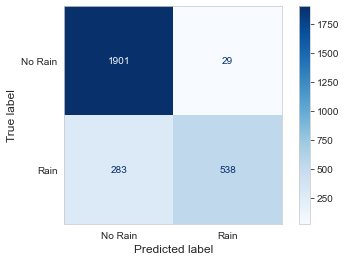

In [249]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

In [250]:
# Classification Report
print(classification_report(y_test, y_pred))
print(balanced_accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.98      0.92      1930
           1       0.95      0.66      0.78       821

    accuracy                           0.89      2751
   macro avg       0.91      0.82      0.85      2751
weighted avg       0.89      0.89      0.88      2751

0.8201362549147065


PART 8 - TESTING ON THE DEMO DATA

--------- KNeighborsClassifier ----------------
Demo Accuracy: 95.0%


c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


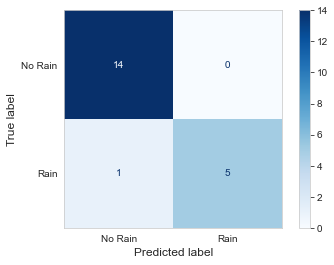

              precision    recall  f1-score   support

           0       0.93      1.00      0.97        14
           1       1.00      0.83      0.91         6

    accuracy                           0.95        20
   macro avg       0.97      0.92      0.94        20
weighted avg       0.95      0.95      0.95        20

--------- LogisticRegression ----------------
Demo Accuracy: 90.0%


c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Temp_9am
Feature names seen at fit time, yet now missing:
- Station

  warnings.warn(message, FutureWarning)


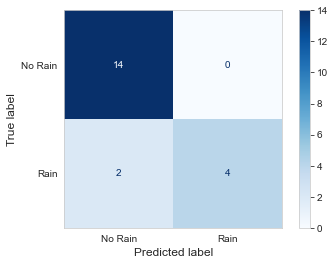

c:\Users\jmanu\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Temp_9am
Feature names seen at fit time, yet now missing:
- Station

  warnings.warn(message, FutureWarning)


              precision    recall  f1-score   support

           0       0.88      1.00      0.93        14
           1       1.00      0.67      0.80         6

    accuracy                           0.90        20
   macro avg       0.94      0.83      0.87        20
weighted avg       0.91      0.90      0.89        20

--------- DecisionTreeClassifier ----------------
Demo Accuracy: 100.0%


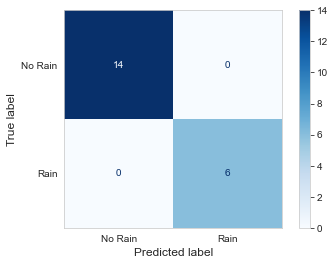

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00         6

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20

--------- SVC ----------------
Demo Accuracy: 90.0%


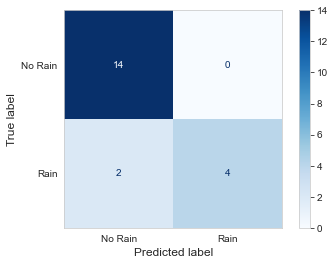

              precision    recall  f1-score   support

           0       0.88      1.00      0.93        14
           1       1.00      0.67      0.80         6

    accuracy                           0.90        20
   macro avg       0.94      0.83      0.87        20
weighted avg       0.91      0.90      0.89        20



In [251]:
# I will implement everythin in one go, we have four models with the parametres already fitted, is time to test.

models = [knn, log_reg, d_tree, svc]

for model in models:
    # Print the name of the model 
    print(f"--------- {model.__class__.__name__} ----------------")

    # Predict 
    if model.__class__.__name__ == "KNeighborsClassifier":
        y_pred = model.predict(X_demo[top6_features[:2]])
    else:
        y_pred = model.predict(X_demo[top6_features])

    # Display the prediction score
    print(f"Demo Accuracy: {accuracy_score(y_pred, y_demo).round(5) * 100}%")

    # Confusion Matrix
    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    import matplotlib.pyplot as plt
    confusion_matrix = confusion_matrix(y_demo, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
    disp.plot(cmap='Blues', xticks_rotation='horizontal')
    disp.ax_.set_xlabel('Predicted label', fontsize=12)
    disp.ax_.set_ylabel('True label', fontsize=12)
    plt.grid(False)
    plt.show()

    # Interpretation
    print(classification_report(y_demo, y_pred))


PART 9 - Ensemble Method 

Bagging Method - Random Forest 

9.1 First Hyperparametres tunning 

In [252]:
# Now we are going to work with our Random Forest, this follows the Bagging Method to train the model 
# We are going to use the GridsearchCV to find parametres. I will keep it on the reserve side to prevent overfitting 
parametres = {
    'n_estimators': [5, 10, 20],
    'max_depth': [None, 5, 10],
    'max_leaf_nodes': [10, 20, 30],
    'min_samples_split': [10, 20, 30],
    'min_samples_leaf': [10, 15, 20],
    'criterion' : ['gini', 'entropy']
}
 

In [253]:
# Now we test the parametres
ran_f = RandomForestClassifier()

# Start the Gridsearch
grid_search = GridSearchCV(ran_f, parametres, cv=5)
grid_search.fit(X_train[top6_features], y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 5, 10],
                         'max_leaf_nodes': [10, 20, 30],
                         'min_samples_leaf': [10, 15, 20],
                         'min_samples_split': [10, 20, 30],
                         'n_estimators': [5, 10, 20]})

In [254]:
# Look at the results 
print("Parameters: ", grid_search.best_params_)
print("Score: ", grid_search.best_score_)

# Results
# Parameters:  {'max_depth': 10, 'min_samples_leaf': 10, 'min_samples_split': 15, 'n_estimators': 10}
# Score:  0.9901118748200816

Parameters:  {'criterion': 'entropy', 'max_depth': None, 'max_leaf_nodes': 10, 'min_samples_leaf': 10, 'min_samples_split': 10, 'n_estimators': 5}
Score:  0.9899500631604408


9.2 Cross Validation Test with Gridsearch Parametres  

In [255]:
# Before we test on Validation, I want to see how the current parametres work in a Cross Validation test, I will use 10
# I'm going to keep the same Random State from now on for the Random Forest
ran_f = RandomForestClassifier(max_depth = 10, 
                               min_samples_leaf = 10, 
                               min_samples_split=15,
                               max_leaf_nodes=30, 
                               n_estimators = 10, 
                               criterion='entropy',
                               random_state=69)
accuracy = cross_val_score(ran_f, X_train[top6_features], y_train, scoring='accuracy', cv = 10)

accuracy

# I'm not really happy with first resutl, I will keep looping fromm 9.1 to 9.2 until I like resutls

array([0.99027553, 0.99027553, 0.98703404, 0.99027553, 0.98379254,
       0.98379254, 0.99675851, 0.99189627, 0.98703404, 0.99350649])

9.3 Test on Validation and Testing

In [256]:
# Test on the validation with final parametres and same random_state
ran_f = RandomForestClassifier(max_depth = 10, 
                               min_samples_leaf = 10, 
                               min_samples_split=15,
                               max_leaf_nodes=30, 
                               n_estimators = 10, 
                               criterion='entropy',
                               random_state=69)

# Train the Classifier
ran_f.fit(X_train[top6_features], y_train)

# Test on Validation and Training
print(f"Training: {accuracy_score(ran_f.predict(X_train[top6_features]), y_train)}")
print(f"Validation: {accuracy_score(ran_f.predict(X_val[top6_features]), y_val)}")
print(f"Test: {accuracy_score(ran_f.predict(X_test[top6_features]), y_test)}")

Training: 0.9914086561841465
Validation: 0.9907901114881241
Test: 0.9920029080334424


9.4 Visualize Results

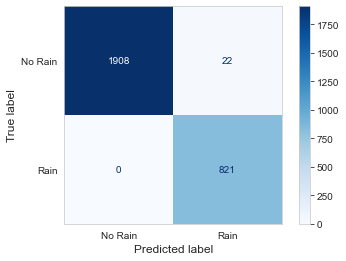

In [257]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_test, ran_f.predict(X_test[top6_features]))
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

In [258]:
# Classification Report
print(classification_report(y_test, ran_f.predict(X_test[top6_features])))
print(balanced_accuracy_score(y_test, ran_f.predict(X_test[top6_features])))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99      1930
           1       0.97      1.00      0.99       821

    accuracy                           0.99      2751
   macro avg       0.99      0.99      0.99      2751
weighted avg       0.99      0.99      0.99      2751

0.9943005181347151


9.5 Demo Data 

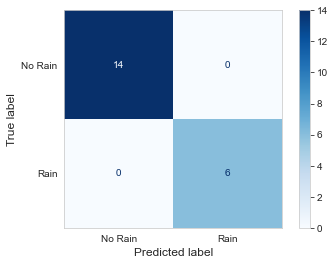

In [259]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Confusion Matrix
confusion_matrix = confusion_matrix(y_demo, ran_f.predict(X_demo[top6_features]))
disp = ConfusionMatrixDisplay(confusion_matrix, display_labels=['No Rain', 'Rain'])
disp.plot(cmap='Blues', xticks_rotation='horizontal')
disp.ax_.set_xlabel('Predicted label', fontsize=12)
disp.ax_.set_ylabel('True label', fontsize=12)
plt.grid(False)
plt.show()

-------------------------------    SECTION 2 : Models Comparasion    -------------------------------

1 - Fitting Models

In [266]:
# KNN
knn = KNeighborsClassifier(n_neighbors=3, metric="euclidean")
knn.fit(X_train[top6_features[:2]], y_train)

# Getting the parametres for the curve 
y_pred_prob_knn = knn.predict_proba(X_test[top6_features[:2]])[:, 1]
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_pred_prob_knn)
auc_knn = roc_auc_score(y_test, y_pred_prob_knn)

In [267]:
# Logistic Regression
log_reg = LogisticRegression(C=10, 
                             penalty='l1', 
                             solver='liblinear')
log_reg.fit(X_train[top6_features], y_train)

# Getting the parametres for the curve 
y_pred_prob_lr = log_reg.predict_proba(X_test[top6_features])[:, 1]
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_pred_prob_lr)
auc_lr = roc_auc_score(y_test, y_pred_prob_lr)

In [268]:
# Decision Tree
d_tree = DecisionTreeClassifier(criterion= 'gini', 
                                max_depth = 2, 
                                max_leaf_nodes= 2, 
                                min_samples_leaf= 50)
d_tree.fit(X_train[top6_features], y_train)

# Getting the parametres for the curve 
y_pred_prob_dt = d_tree.predict_proba(X_test[top6_features])[:, 1]
fpr_dt, tpr_dt, _ = roc_curve(y_test, y_pred_prob_dt)
auc_dt = roc_auc_score(y_test, y_pred_prob_dt)

In [269]:
# SVC
svc = svm.SVC(kernel='poly', degree=4, probability=True)
svc.fit(X_train[top6_features], y_train)

# Getting the parametres for the curve 
y_pred_prob_svc = svc.decision_function(X_test[top6_features])
fpr_svc, tpr_svc, _ = roc_curve(y_test, y_pred_prob_svc)
auc_svc = roc_auc_score(y_test, y_pred_prob_svc)

In [270]:
y_tes = pd.DataFrame(y_pred_prob_svc)

y_tes = y_tes[0].apply(lambda x: 0 if x < 0 else 1)

print("Acc",accuracy_score(y_tes, y_test))

print("CR",classification_report(y_test, y_tes))
roc_auc_score(y_test, y_pred_prob_svc)

Acc 0.8865866957470011
CR               precision    recall  f1-score   support

           0       0.87      0.98      0.92      1930
           1       0.95      0.66      0.78       821

    accuracy                           0.89      2751
   macro avg       0.91      0.82      0.85      2751
weighted avg       0.89      0.89      0.88      2751



0.9905271594731561

In [271]:
# Random Forest
ran_f = RandomForestClassifier(max_depth = 10, 
                               min_samples_leaf = 10, 
                               min_samples_split=15,
                               max_leaf_nodes=30, 
                               n_estimators = 10, 
                               criterion='entropy',
                               random_state=69)
ran_f.fit(X_train[top6_features], y_train)

# Getting the parametres for the curve
y_pred_prob_rf = ran_f.predict_proba(X_test[top6_features])[:, 1]
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_prob_rf)
auc_rf = roc_auc_score(y_test, y_pred_prob_rf)

2 - ROC Curve

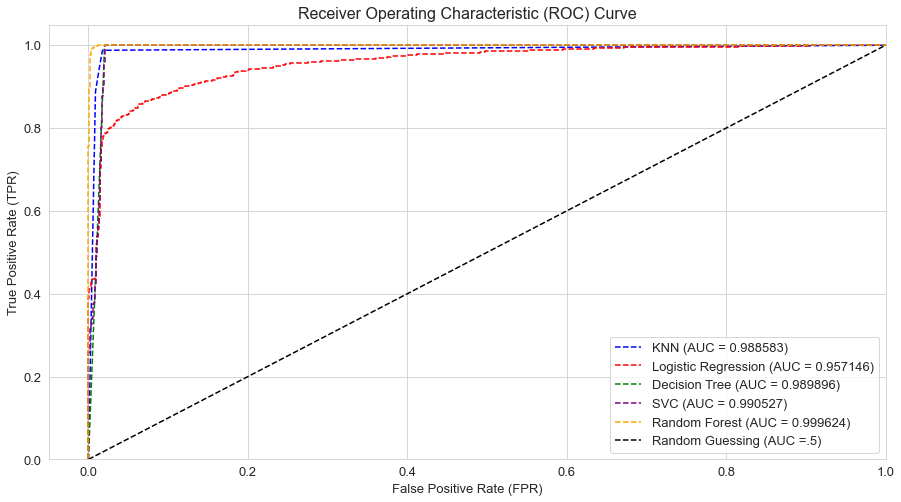

In [283]:
# Plot ROC curves
plt.figure(figsize=(15, 8))
plt.plot(fpr_knn, tpr_knn, color='blue', linestyle='--', label='KNN (AUC = {:.6f})'.format(auc_knn))
plt.plot(fpr_lr, tpr_lr, color='red', linestyle='--', label='Logistic Regression (AUC = {:.6f})'.format(auc_lr))
plt.plot(fpr_dt, tpr_dt, color='green', linestyle='--', label='Decision Tree (AUC = {:.6f})'.format(auc_dt))
plt.plot(fpr_svc, tpr_svc, color='purple', linestyle='--', label='SVC (AUC = {:.6f})'.format(auc_svc))
plt.plot(fpr_rf, tpr_rf, color='orange', linestyle='--', label='Random Forest (AUC = {:.6f})'.format(auc_rf))
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing (AUC =.5)')  
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (FPR)',fontsize=13)
plt.ylabel('True Positive Rate (TPR)', fontsize=13)
plt.yticks(fontsize=13)
plt.xticks(fontsize=13)
plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=16)
plt.legend(loc='lower right', fontsize=13)
plt.grid(True)
plt.show()

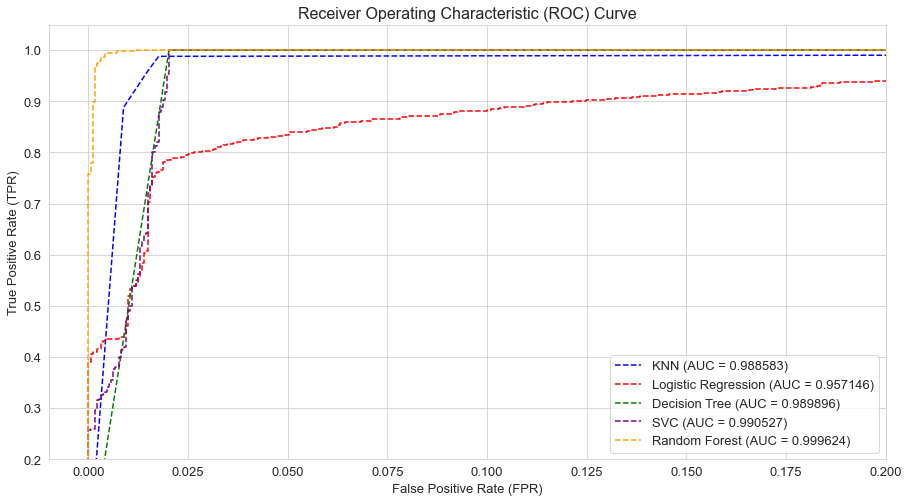

In [284]:
# Zoomed ROC Curve
plt.figure(figsize=(15, 8))
plt.plot(fpr_knn, tpr_knn, color='blue', linestyle='--', label='KNN (AUC = {:.6f})'.format(auc_knn))
plt.plot(fpr_lr, tpr_lr, color='red', linestyle='--', label='Logistic Regression (AUC = {:.6f})'.format(auc_lr))
plt.plot(fpr_dt, tpr_dt, color='green', linestyle='--', label='Decision Tree (AUC = {:.6f})'.format(auc_dt))
plt.plot(fpr_svc, tpr_svc, color='purple', linestyle='--', label='SVC (AUC = {:.6f})'.format(auc_svc))
plt.plot(fpr_rf, tpr_rf, color='orange', linestyle='--', label='Random Forest (AUC = {:.6f})'.format(auc_rf))
plt.xlim([-0.01, 0.2])
plt.ylim([0.2, 1.05])
plt.xlabel('False Positive Rate (FPR)',fontsize=13)
plt.ylabel('True Positive Rate (TPR)', fontsize=13)
plt.yticks(fontsize=13)
plt.xticks(fontsize=13)
plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=16)
plt.legend(loc='lower right', fontsize=13)
plt.grid(True)
plt.show()